Соревнование Kaggle https://www.kaggle.com/competitions/leopard-challenge-regression/leaderboardтаство объектов в округе
id – id объекта

Задача - разработка решения для оценки объектов недвижимости в Мельбурне. Регрессия, метрика MAE. 

Краткий план работы:

1. установка библиотек и инструментов / загрузка данных
2. EDA
3. подготовка данных к ML
4. ML
5. Анализ моделей
6. Вывод

### 1. Установка библиотек и инструментов / загрузка данных

In [1]:
!pip install phik shap catboost lightgbm category_encoders optuna osmnx kaggle -q

In [2]:
import seaborn as sns
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import phik
import os
import re
import osmnx as ox
import plotly.express as px
import lightgbm as lgb
import optuna
import shap
import zipfile
from sklearn.pipeline import Pipeline, make_pipeline, FeatureUnion
from sklearn.compose import ColumnTransformer, make_column_selector
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from optuna.samplers import TPESampler
from sklearn.base import BaseEstimator, TransformerMixin
from category_encoders import CatBoostEncoder
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, PolynomialFeatures
from sklearn.feature_selection import SelectKBest, f_regression, SelectFromModel
from sklearn.metrics import make_scorer, mean_absolute_percentage_error
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from lightgbm import early_stopping

In [3]:
os.environ['KAGGLE_CONFIG_DIR'] = r'C:\Users\solov'

In [4]:
!kaggle competitions download -c leopard-challenge-regression

leopard-challenge-regression.zip: Skipping, found more recently modified local copy (use --force to force download)


In [5]:
with zipfile.ZipFile('leopard-challenge-regression.zip', 'r') as zip_ref:
    zip_ref.extractall('data')

In [6]:
df = pd.read_csv('data/train.csv')

In [7]:
test = pd.read_csv('data/test.csv')

#### 2. EDA

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18373 entries, 0 to 18372
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         18373 non-null  object 
 1   Address        18373 non-null  object 
 2   Rooms          18373 non-null  int64  
 3   Type           18373 non-null  object 
 4   Price          18373 non-null  float64
 5   Method         18373 non-null  object 
 6   SellerG        18373 non-null  object 
 7   Date           18373 non-null  object 
 8   Distance       18373 non-null  float64
 9   Postcode       18373 non-null  float64
 10  Bedroom2       14905 non-null  float64
 11  Bathroom       14903 non-null  float64
 12  Car            14798 non-null  float64
 13  Landsize       13579 non-null  float64
 14  BuildingArea   7750 non-null   float64
 15  YearBuilt      8944 non-null   float64
 16  CouncilArea    18372 non-null  object 
 17  Lattitude      15041 non-null  float64
 18  Longti

In [9]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8818 entries, 0 to 8817
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         8818 non-null   object 
 1   Address        8818 non-null   object 
 2   Rooms          8818 non-null   int64  
 3   Type           8818 non-null   object 
 4   Method         8818 non-null   object 
 5   SellerG        8818 non-null   object 
 6   Date           8818 non-null   object 
 7   Distance       8817 non-null   float64
 8   Postcode       8817 non-null   float64
 9   Bedroom2       5858 non-null   float64
 10  Bathroom       5854 non-null   float64
 11  Car            5582 non-null   float64
 12  Landsize       4365 non-null   float64
 13  BuildingArea   2882 non-null   float64
 14  YearBuilt      3112 non-null   float64
 15  CouncilArea    8816 non-null   object 
 16  Lattitude      5908 non-null   float64
 17  Longtitude     5908 non-null   float64
 18  Regionna

Много пропусков, внимательнее рассмотрим.

In [10]:
def check_df(df):
    missing_percentage = df.isnull().mean() * 100
    print('Процент пропусков по столбцам:')
    print(missing_percentage)
    duplicate_count = df.duplicated().sum()
    print('\nКоличество дубликатов в DF:', duplicate_count)

In [11]:
check_df(df)

Процент пропусков по столбцам:
Suburb            0.000000
Address           0.000000
Rooms             0.000000
Type              0.000000
Price             0.000000
Method            0.000000
SellerG           0.000000
Date              0.000000
Distance          0.000000
Postcode          0.000000
Bedroom2         18.875524
Bathroom         18.886409
Car              19.457900
Landsize         26.092636
BuildingArea     57.818538
YearBuilt        51.319872
CouncilArea       0.005443
Lattitude        18.135307
Longtitude       18.135307
Regionname        0.005443
Propertycount     0.005443
id                0.000000
dtype: float64

Количество дубликатов в DF: 0


In [12]:
check_df(test)

Процент пропусков по столбцам:
Suburb            0.000000
Address           0.000000
Rooms             0.000000
Type              0.000000
Method            0.000000
SellerG           0.000000
Date              0.000000
Distance          0.011340
Postcode          0.011340
Bedroom2         33.567702
Bathroom         33.613064
Car              36.697664
Landsize         50.498979
BuildingArea     67.316852
YearBuilt        64.708551
CouncilArea       0.022681
Lattitude        33.000680
Longtitude       33.000680
Regionname        0.022681
Propertycount     0.022681
id                0.000000
dtype: float64

Количество дубликатов в DF: 0


Можно использовать различные геокодеры для заполнения пропусков в широте/долготе , я использую osmx тк он очень простой и у него нет лимита и проблем с подключением.

In [13]:
def geocode_address(address):
    try:
        result = ox.geocode(address)
        if result:
            return result[0], result[1]
        else:
            return None, None
    except Exception as e:
        print(f"Ошибка для: {e}")
        return None, None

In [14]:
missing_locations = df[df['Lattitude'].isnull() | df['Longtitude'].isnull()]['Address'].unique()

for address in missing_locations:
    full_address = f"{address}, Melbourne, Australia"  
    lat, lon = geocode_address(full_address)
    if lat is not None and lon is not None:
        df.loc[df['Address'] == address, 'Lattitude'] = lat
        df.loc[df['Address'] == address, 'Longtitude'] = lon

Ошибка для: Nominatim could not geocode query '403/609 Victoria St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '10 Freemans St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '10/392 New St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '102/747 Sydney Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '8/688 Inkerman Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '17/790 Elgar Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '15 Parkhill Wy, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '10/488 Glenhuntly Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '250 Pinoak Cr, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '306/277 Barkly St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '8/64 Edgar St Nth, Melbourne, Australia'
Ошибка для: Nominatim could not geocode que

In [15]:
missing_locations = test[test['Lattitude'].isnull() | test['Longtitude'].isnull()]['Address'].unique()

for address in missing_locations:
    full_address = f"{address}, Melbourne, Australia"  
    lat, lon = geocode_address(full_address)
    if lat is not None and lon is not None:
        test.loc[test['Address'] == address, 'Lattitude'] = lat
        test.loc[test['Address'] == address, 'Longtitude'] = lon

Ошибка для: Nominatim could not geocode query '7/576 Glenferrie Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '101/598 St Kilda Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '407/163 Cremorne St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '10/679 Toorak Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '315/140 Swan St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '39/562 Little Bourke St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '2/68 De Carle St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '6/799 Burwood Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '906/70 Speakmen St, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '202/179 Neerim Rd, Melbourne, Australia'
Ошибка для: Nominatim could not geocode query '9/293 Kooyong Rd, Melbourne, Australia'
Ошибка для: Nominatim cou

Успех! Очень много пропусков заполнено.

In [16]:
df.describe(include = 'all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Suburb,18373,329,Reservoir,540,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Address,18373,18112,28 Blair St,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Rooms,18373.0,NaN,NaN,NaN,2.936592,0.955952,1.0,2.0,3.0,3.0,12.0
Type,18373,3,h,12091,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Price,18373.0,NaN,NaN,NaN,1053234.882218,621797.251963,227000.0,635000.0,880000.0,1301000.0,5580000.0
Method,18373,5,S,12025,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SellerG,18373,305,Nelson,2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Date,18373,59,27/05/2017,610,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Distance,18373.0,NaN,NaN,NaN,10.403962,6.018424,0.0,6.3,9.7,13.3,48.1
Postcode,18373.0,NaN,NaN,NaN,3107.258314,95.285542,3000.0,3046.0,3085.0,3149.0,3978.0


Общий статистический анализ и видно странные данные в площади и колличестве комнат

In [17]:
def analyze_df(df):
    for column in df.columns:
        if df[column].dtype == 'object':
            unique_values = df[column].nunique()
            print(f"Количество уникальных значений в столбце '{column}': {unique_values}")
            print(f"Уникальные значения в столбце '{column}':")
            print(df[column].unique())

            fig = px.histogram(df, x=column, title=f"Распределение {column}")
            fig.show()
        else:
            q1 = df[column].quantile(0.25)
            q3 = df[column].quantile(0.75)
            iqr = q3 - q1
            lower_bound = q1 - 1.5 * iqr
            upper_bound = q3 + 1.5 * iqr
            outliers_count = ((df[column] < lower_bound) | (df[column] > upper_bound)).sum()
            print(f"Количество строк с выбросами в столбце '{column}': {outliers_count}")
            
            fig_histogram = px.histogram(df, x=column, title=f"Распреление {column}")
            fig_histogram.show()

Количество уникальных значений в столбце 'Suburb': 329
Уникальные значения в столбце 'Suburb':
['Abbotsford' 'Airport West' 'Albert Park' 'Alphington' 'Altona'
 'Altona North' 'Armadale' 'Ascot Vale' 'Ashburton' 'Ashwood'
 'Avondale Heights' 'Balaclava' 'Balwyn' 'Balwyn North' 'Bentleigh'
 'Bentleigh East' 'Box Hill' 'Braybrook' 'Brighton' 'Brighton East'
 'Brunswick' 'Brunswick West' 'Bulleen' 'Burwood' 'Camberwell'
 'Canterbury' 'Carlton North' 'Carnegie' 'Caulfield' 'Caulfield North'
 'Caulfield South' 'Chadstone' 'Clifton Hill' 'Coburg' 'Coburg North'
 'Collingwood' 'Doncaster' 'Eaglemont' 'Elsternwick' 'Elwood' 'Essendon'
 'Essendon North' 'Fairfield' 'Fitzroy' 'Fitzroy North' 'Flemington'
 'Footscray' 'Glen Iris' 'Glenroy' 'Gowanbrae' 'Hadfield' 'Hampton'
 'Hampton East' 'Hawthorn' 'Heidelberg Heights' 'Heidelberg West'
 'Hughesdale' 'Ivanhoe' 'Kealba' 'Keilor East' 'Kensington' 'Kew'
 'Kew East' 'Kooyong' 'Maidstone' 'Malvern' 'Malvern East' 'Maribyrnong'
 'Melbourne' 'Middle Pa

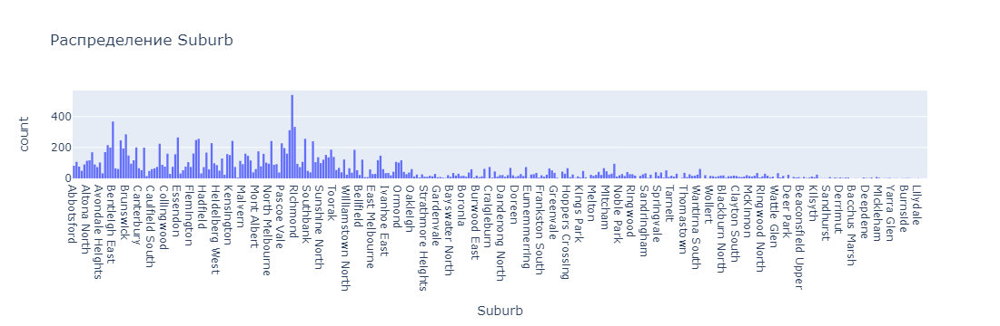

Количество уникальных значений в столбце 'Address': 18112
Уникальные значения в столбце 'Address':
['85 Turner St' '25 Bloomburg St' '5 Charles St' ... '14 Stainsby Cr'
 '30 Waddington Cr' '42 Pascoe St']


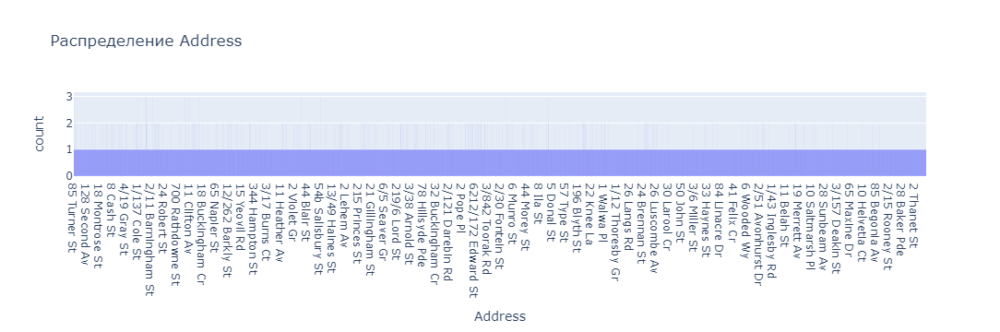

Количество строк с выбросами в столбце 'Rooms': 888


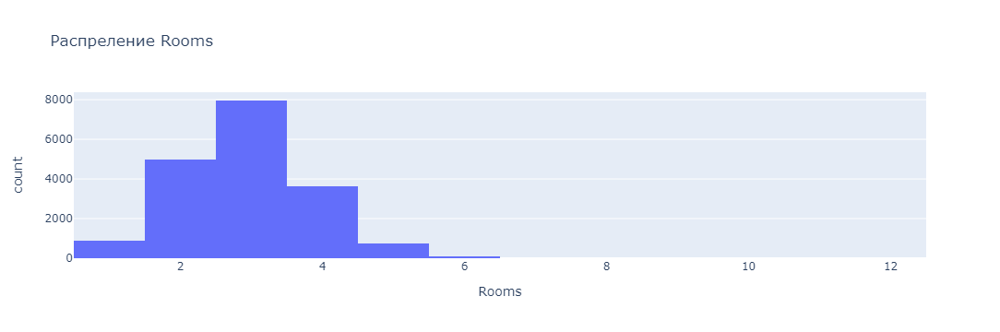

Количество уникальных значений в столбце 'Type': 3
Уникальные значения в столбце 'Type':
['h' 't' 'u']


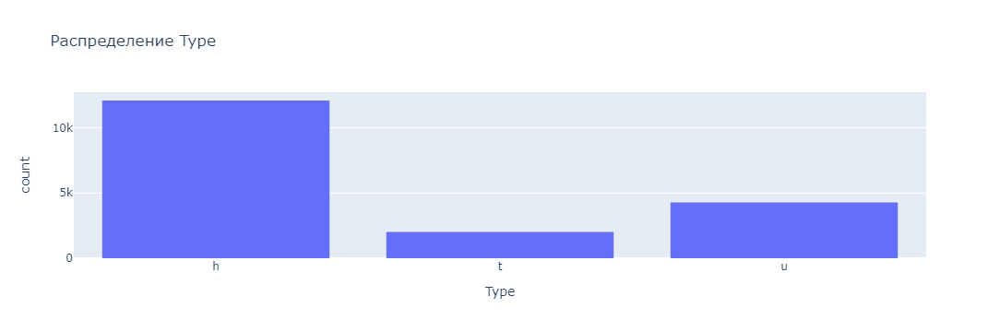

Количество строк с выбросами в столбце 'Price': 843


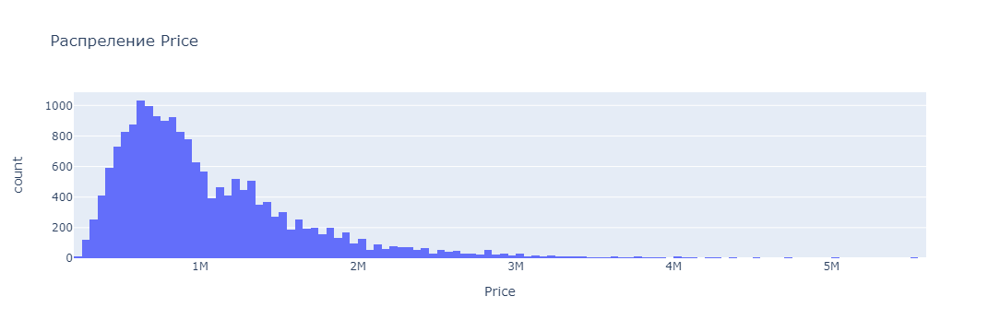

Количество уникальных значений в столбце 'Method': 5
Уникальные значения в столбце 'Method':
['S' 'SP' 'PI' 'VB' 'SA']


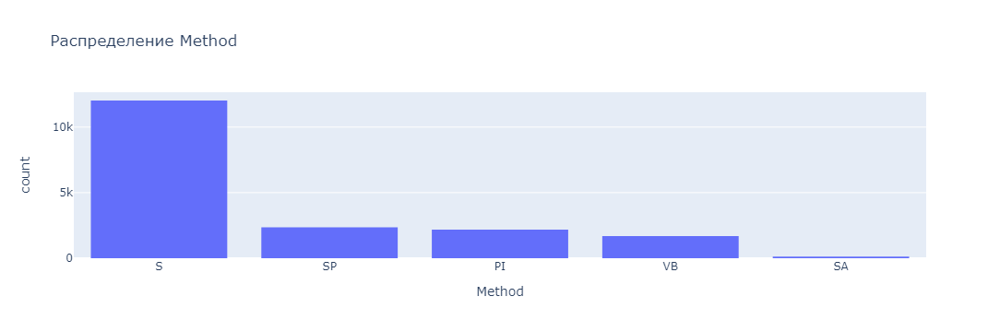

Количество уникальных значений в столбце 'SellerG': 305
Уникальные значения в столбце 'SellerG':
['Biggin' 'Nelson' 'Jellis' 'Dingle' 'Purplebricks' 'Greg' 'LITTLE'
 'Collins' 'Kay' 'Beller' 'Marshall' 'hockingstuart' 'Brad' 'Maddison'
 'Barry' 'Airport' 'Considine' 'Rendina' 'Ray' 'Propertyau' 'McDonald'
 'Frank' 'Prof.' 'Harcourts' 'Thomson' 'Buxton' 'RT' "Sotheby's" 'Cayzer'
 'Chisholm' 'Brace' 'Miles' 'Holland' 'McGrath' 'Love' 'Thomas' 'Barlow'
 'Sweeney' 'Village' 'Jas' 'Williams' 'Gunn&Co' 'Burnham' 'Compton' 'FN'
 'Hunter' 'Raine&Horne' 'Noel' 'Hodges' 'Gary' 'Fletchers' 'Woodards'
 'Raine' 'Alexkarbon' 'Walshe' 'Weda' 'Stockdale' 'Tim' 'AIME' 'Moonee'
 'HAR' 'Edward' 'Philip' 'RW' 'North' 'MICM' 'Ascend' 'Christopher'
 'Morrison' 'Mandy' 'R&H' 'Fletchers/One' 'Lindellas' 'Appleby' 'Assisi'
 'One' 'Owen' 'Parkes' 'C21' "O'Brien" 'Bayside' 'Paul'
 'hockingstuart/Buxton' 'First' 'Matthew' 'Melbourne' 'Anderson' 'Nick'
 'Allens' 'Bells' 'Trimson' 'Douglas' 'Batty' 'GL' 'YPA' "Tier

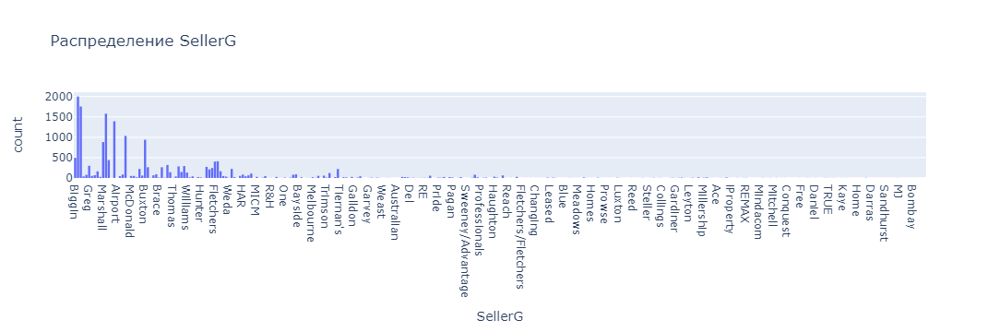

Количество уникальных значений в столбце 'Date': 59
Уникальные значения в столбце 'Date':
['3/12/2016' '4/02/2016' '4/03/2017' '4/06/2016' '7/05/2016' '8/10/2016'
 '10/12/2016' '12/11/2016' '13/08/2016' '14/05/2016' '15/10/2016'
 '16/07/2016' '17/09/2016' '18/03/2017' '18/06/2016' '19/11/2016'
 '22/05/2016' '22/08/2016' '23/04/2016' '24/09/2016' '25/02/2017'
 '26/07/2016' '27/11/2016' '28/05/2016' '30/07/2016' '3/09/2016'
 '6/08/2016' '7/11/2016' '10/09/2016' '11/02/2017' '16/04/2016'
 '27/06/2016' '28/08/2016' '12/06/2016' '11/03/2017' '28/01/2016'
 '6/05/2017' '8/04/2017' '13/05/2017' '29/04/2017' '20/05/2017'
 '22/04/2017' '1/07/2017' '3/06/2017' '17/06/2017' '24/06/2017'
 '27/05/2017' '8/07/2017' '12/08/2017' '15/07/2017' '22/07/2017'
 '29/07/2017' '3/09/2017' '9/09/2017' '16/09/2017' '19/08/2017'
 '23/09/2017' '26/08/2017' '30/09/2017']


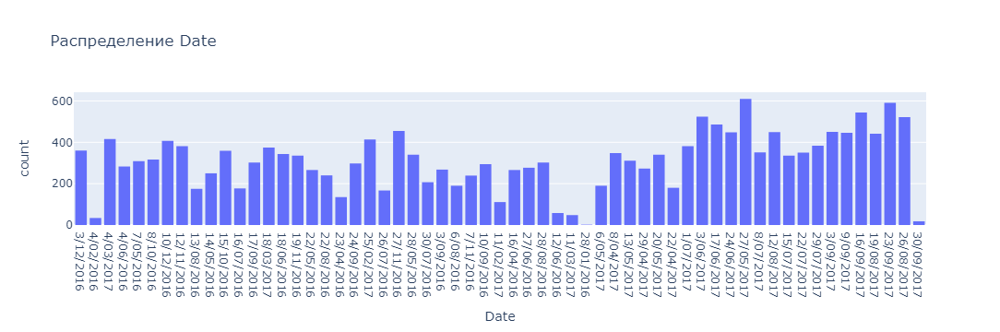

Количество строк с выбросами в столбце 'Distance': 600


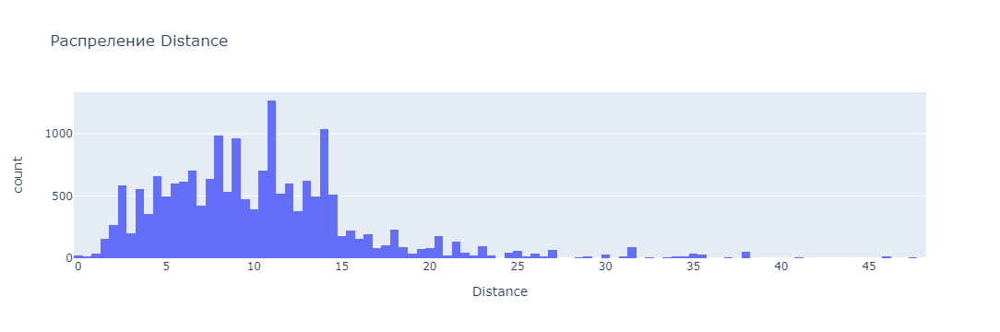

Количество строк с выбросами в столбце 'Postcode': 318


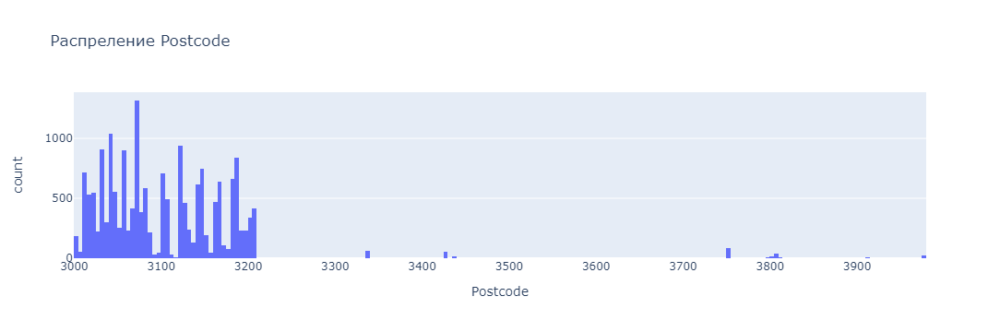

Количество строк с выбросами в столбце 'Bedroom2': 709


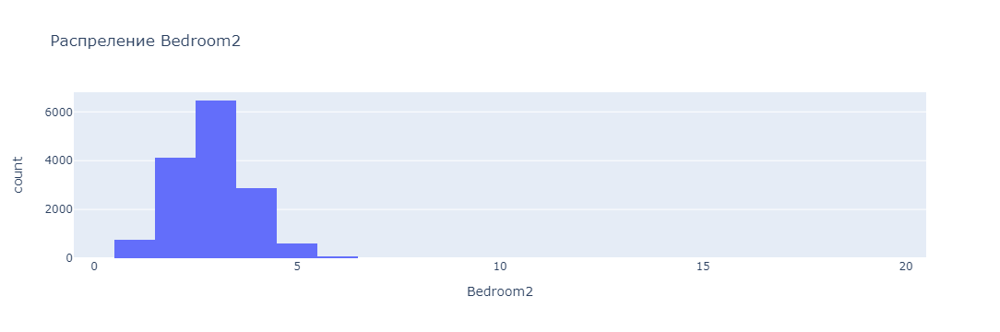

Количество строк с выбросами в столбце 'Bathroom': 150


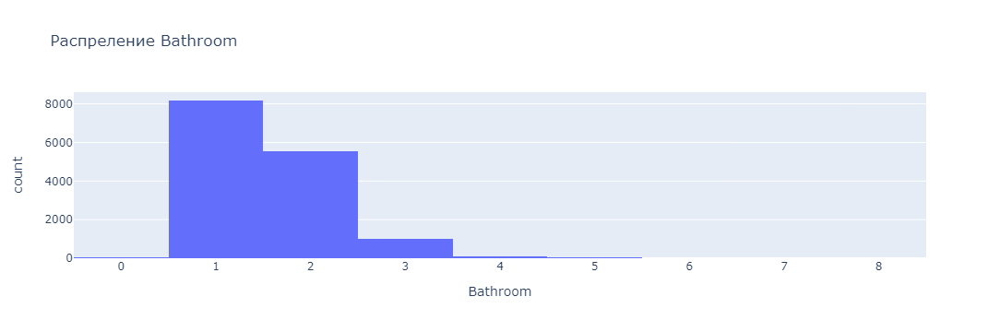

Количество строк с выбросами в столбце 'Car': 701


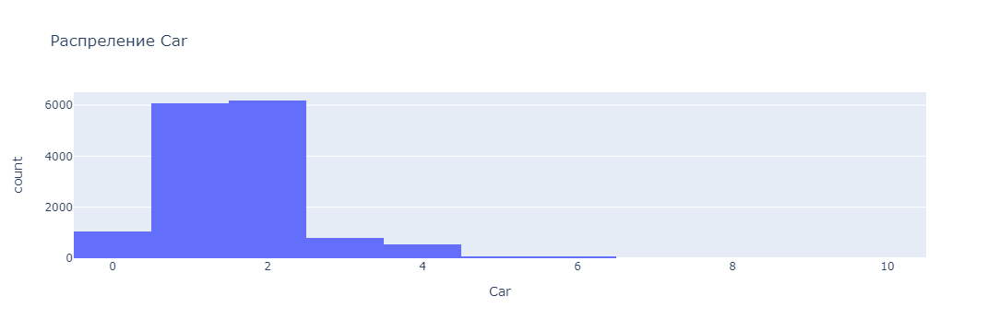

Количество строк с выбросами в столбце 'Landsize': 367


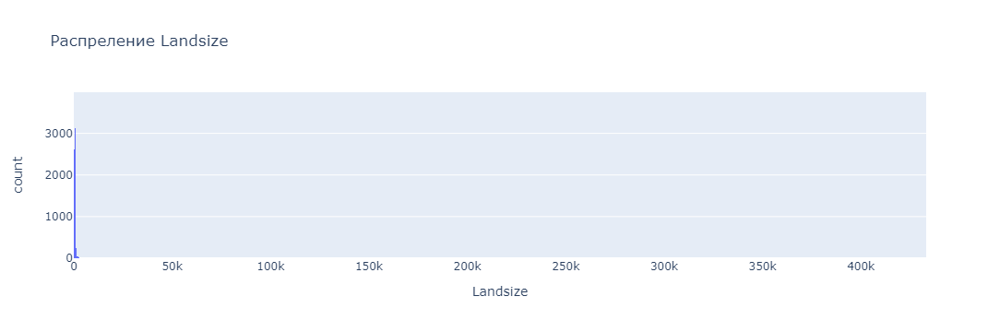

Количество строк с выбросами в столбце 'BuildingArea': 379


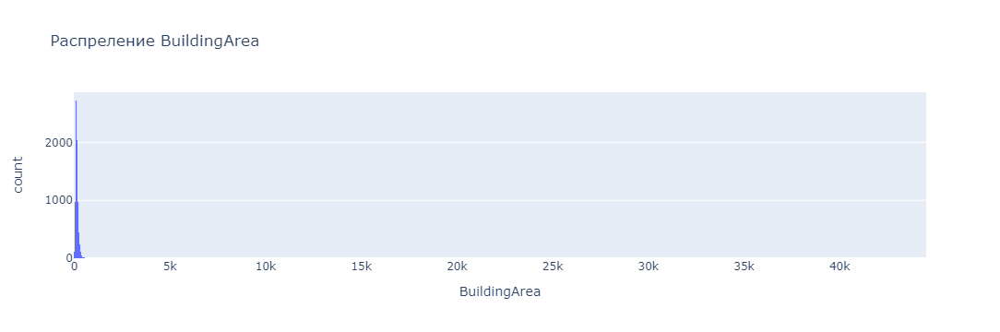

Количество строк с выбросами в столбце 'YearBuilt': 20


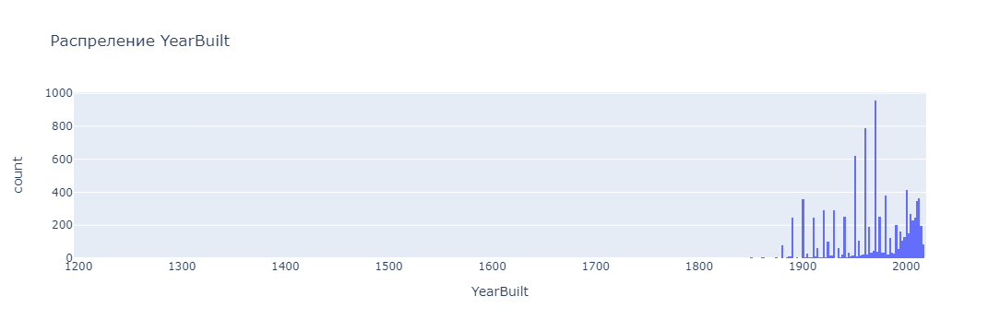

Количество уникальных значений в столбце 'CouncilArea': 33
Уникальные значения в столбце 'CouncilArea':
['Yarra City Council' 'Moonee Valley City Council'
 'Port Phillip City Council' 'Darebin City Council'
 'Hobsons Bay City Council' 'Stonnington City Council'
 'Boroondara City Council' 'Monash City Council' 'Glen Eira City Council'
 'Whitehorse City Council' 'Maribyrnong City Council'
 'Bayside City Council' 'Moreland City Council' 'Manningham City Council'
 'Melbourne City Council' 'Banyule City Council' 'Brimbank City Council'
 'Kingston City Council' 'Hume City Council' 'Knox City Council'
 'Maroondah City Council' 'Casey City Council' 'Melton City Council'
 'Greater Dandenong City Council' 'Nillumbik Shire Council'
 'Whittlesea City Council' 'Frankston City Council'
 'Macedon Ranges Shire Council' 'Yarra Ranges Shire Council'
 'Wyndham City Council' 'Cardinia Shire Council' 'Moorabool Shire Council'
 nan 'Mitchell Shire Council']


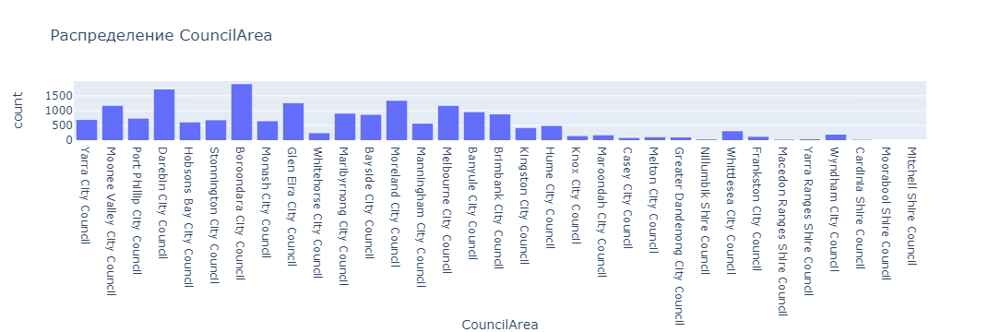

Количество строк с выбросами в столбце 'Lattitude': 529


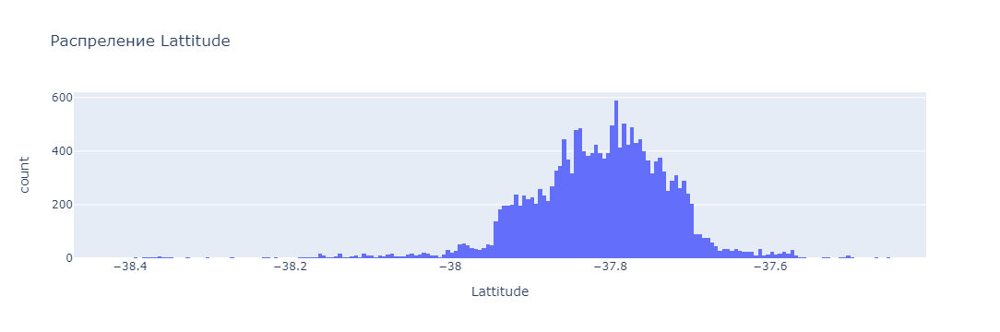

Количество строк с выбросами в столбце 'Longtitude': 737


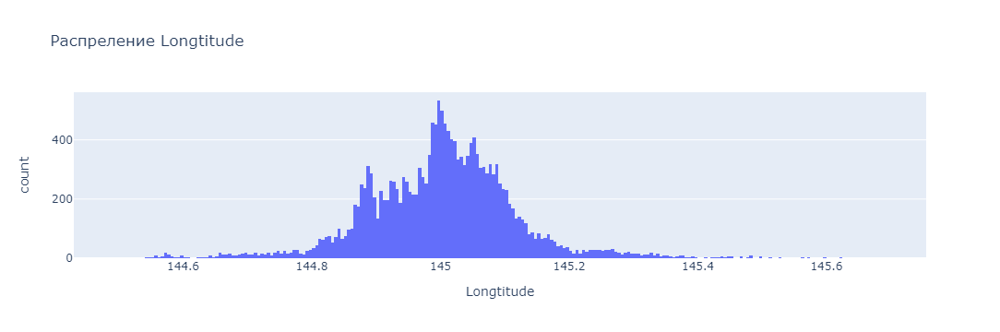

Количество уникальных значений в столбце 'Regionname': 8
Уникальные значения в столбце 'Regionname':
['Northern Metropolitan' 'Western Metropolitan' 'Southern Metropolitan'
 'Eastern Metropolitan' 'South-Eastern Metropolitan' 'Eastern Victoria'
 'Northern Victoria' 'Western Victoria' nan]


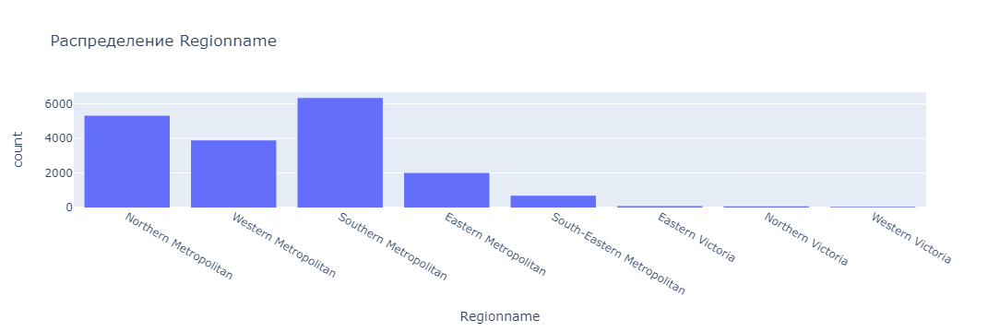

Количество строк с выбросами в столбце 'Propertycount': 540


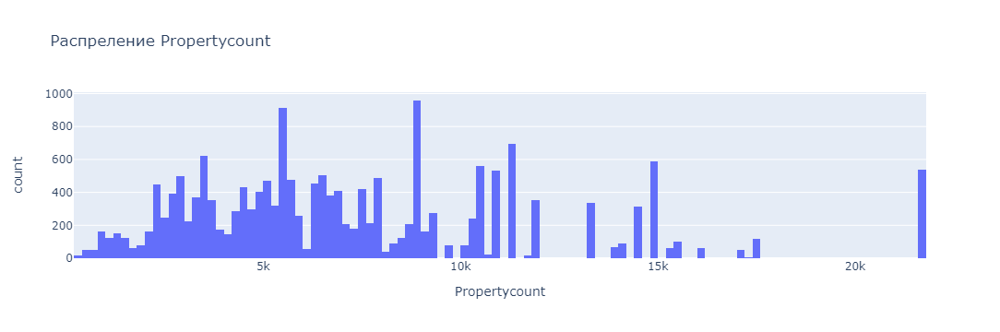

Количество строк с выбросами в столбце 'id': 0


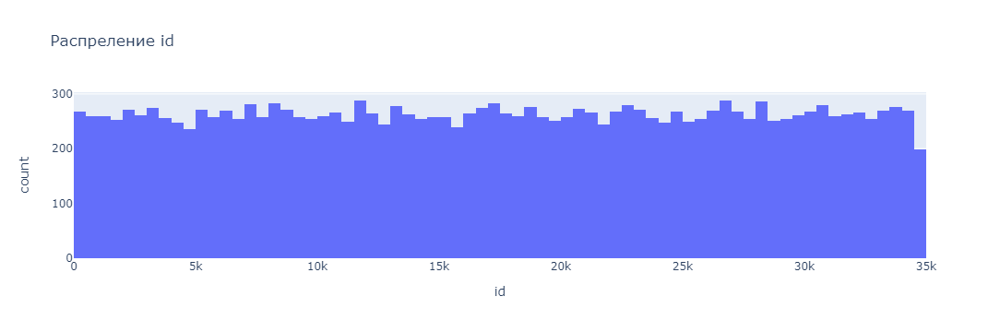

In [18]:
analyze_df(df)

Количество уникальных значений в столбце 'Suburb': 332
Уникальные значения в столбце 'Suburb':
['Abbotsford' 'Airport West' 'Albion' 'Altona' 'Altona Meadows'
 'Altona North' 'Ardeer' 'Ascot Vale' 'Avondale Heights' 'Bacchus Marsh'
 'Balaclava' 'Balwyn' 'Balwyn North' 'Beaumaris' 'Bellfield' 'Bentleigh'
 'Bentleigh East' 'Berwick' 'Blackburn' 'Blackburn North' 'Boronia'
 'Box Hill' 'Brighton East' 'Broadmeadows' 'Brunswick' 'Brunswick East'
 'Brunswick West' 'Bundoora' 'Burwood' 'Camberwell' 'Campbellfield'
 'Canterbury' 'Carlton' 'Carlton North' 'Carnegie' 'Caulfield North'
 'Caulfield South' 'Chadstone' 'Chelsea' 'Chelsea Heights' 'Cheltenham'
 'Chirnside Park' 'Clarinda' 'Clayton' 'Clayton South' 'Clifton Hill'
 'Coburg' 'Coburg North' 'Collingwood' 'Coolaroo' 'Craigieburn'
 'Cranbourne' 'Cremorne' 'Croydon' 'Dallas' 'Dandenong' 'Deer Park'
 'Delahey' 'Dingley Village' 'Docklands' 'Doncaster' 'Doncaster East'
 'Donvale' 'East Melbourne' 'Edithvale' 'Elsternwick' 'Eltham' 'Elwood'
 '

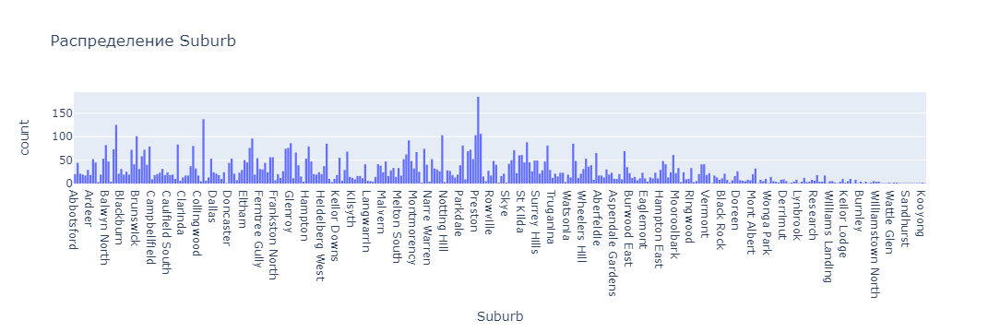

Количество уникальных значений в столбце 'Address': 8763
Уникальные значения в столбце 'Address':
['513/6 Acacia Pl' '60 Charles St' '38 Studley St' ... '147A Severn St'
 '12/37 Stephen St' '3 Tarrengower St']


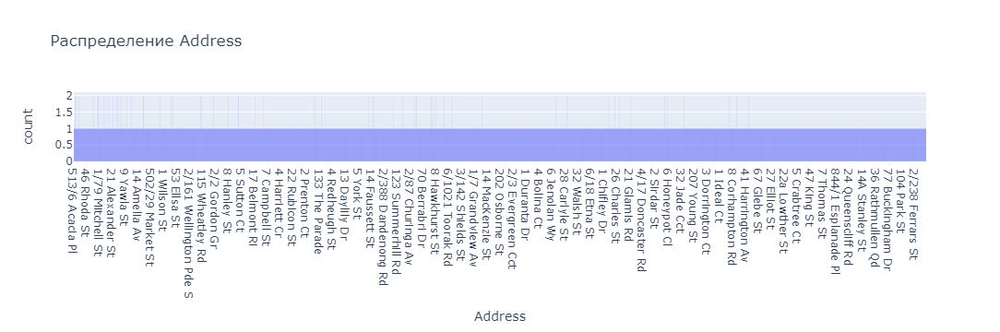

Количество строк с выбросами в столбце 'Rooms': 343


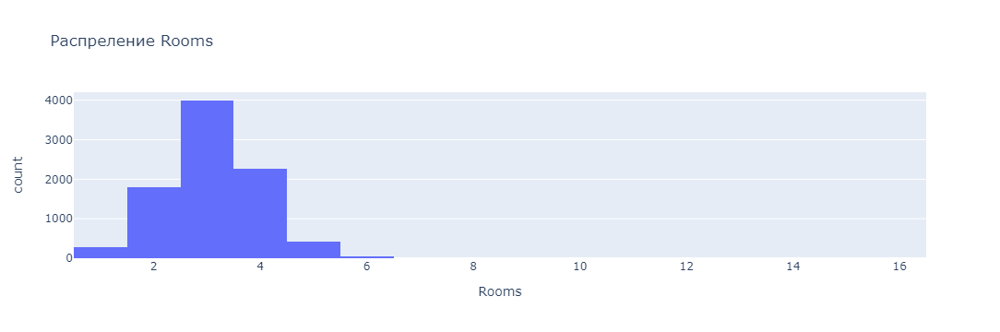

Количество уникальных значений в столбце 'Type': 3
Уникальные значения в столбце 'Type':
['u' 'h' 't']


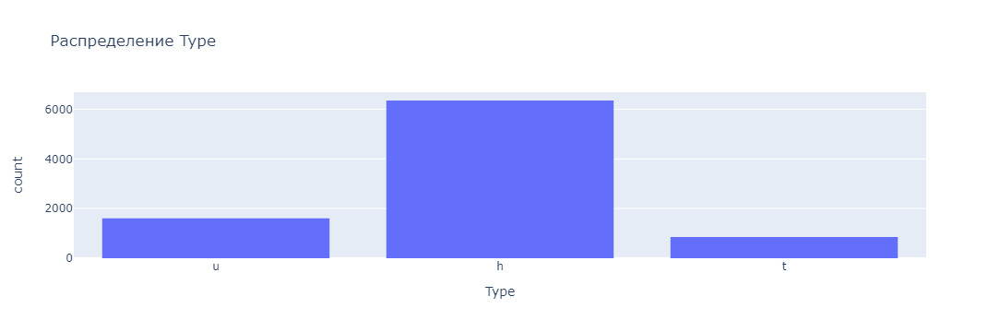

Количество уникальных значений в столбце 'Method': 5
Уникальные значения в столбце 'Method':
['S' 'PI' 'SP' 'VB' 'SA']


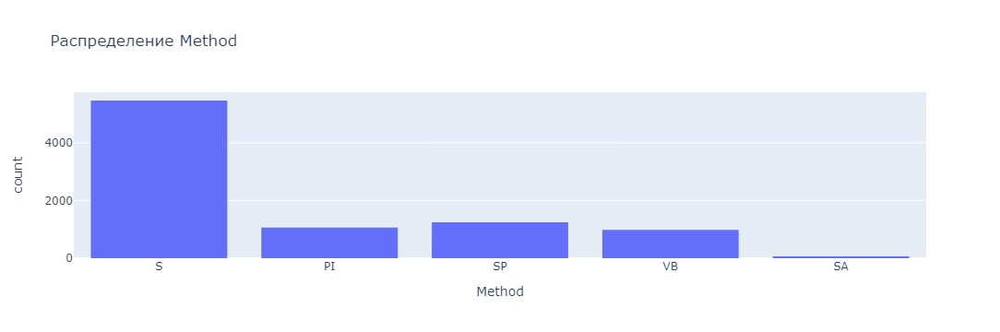

Количество уникальных значений в столбце 'SellerG': 238
Уникальные значения в столбце 'SellerG':
['Dingle' 'Jellis' 'Nelson' 'Raine' 'Barry' 'Douglas' 'Bells' 'Greg'
 'hockingstuart' 'Brad' 'Moonee' 'FN' 'McGrath' 'Noel' 'Bayside' 'William'
 'Buxton' 'Gary' 'LJ' 'Ray' 'Fletchers' 'Hodges' 'RW' 'Stockdale' 'Re'
 'Walshe' 'Peter' 'Nicholson' 'Win' 'HAR' 'Woodards' 'Purplebricks'
 'Eview' 'Thomson' "O'Brien" 'Collins' 'Jason' 'YPA' 'Biggin' 'LJH' 'C21'
 'Prof.' 'Calder' 'MICM' 'Parkes' 'Morrison' 'Buckingham' 'Chisholm'
 'Ristic' 'Melbourne' 'Iconek' 'Bullen' 'Appleby' 'Pagan' 'Jas'
 'Harcourts' 'Charlton' 'WHITEFOX' 'Marshall' 'Philip' 'Miles' 'Collings'
 'Reliance' 'Burnham' 'Rendina' 'Love' 'Aquire' 'S&L' 'Darren' 'Flannagan'
 'PRDNationwide' 'Ryder' 'The' 'Frank' 'McDonald' 'Williams' 'Sweeney'
 'JMRE' 'Hall' 'Munn' 'iSell' 'Considine' 'Leeburn' 'One' 'PRD' 'GL' 'RT'
 'Alexkarbon' 'Barlow' 'Tim' 'iTRAK' 'Rodney' 'Harrington' 'Red' 'Caine'
 'Morleys' 'McLennan' 'Ash' 'J' 'Edward' 'Kay'

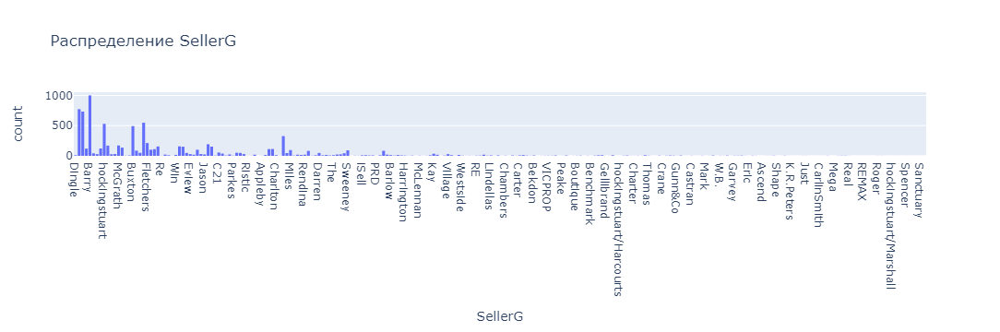

Количество уникальных значений в столбце 'Date': 19
Уникальные значения в столбце 'Date':
['7/10/2017' '14/10/2017' '21/10/2017' '28/10/2017' '4/11/2017'
 '11/11/2017' '18/11/2017' '25/11/2017' '6/01/2018' '9/12/2017'
 '3/02/2018' '10/02/2018' '20/01/2018' '27/01/2018' '3/03/2018'
 '10/03/2018' '17/02/2018' '17/03/2018' '24/02/2018']


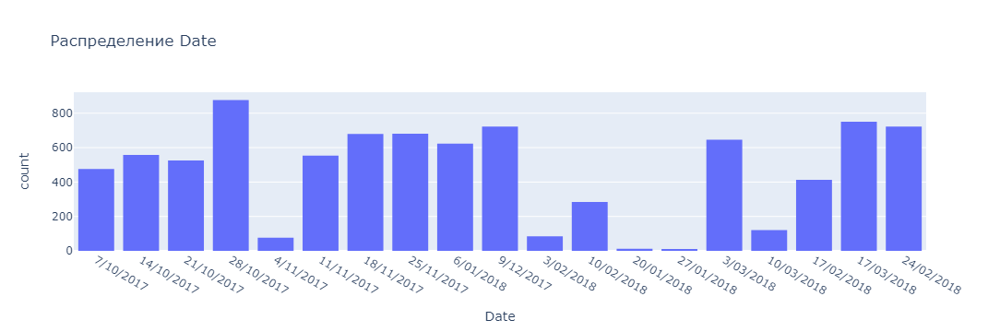

Количество строк с выбросами в столбце 'Distance': 208


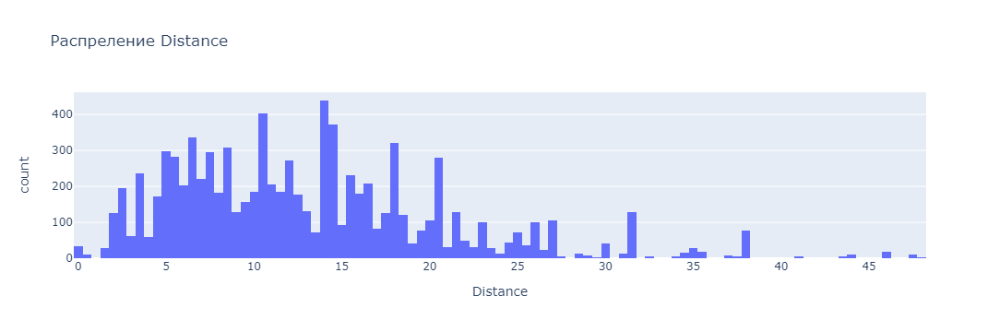

Количество строк с выбросами в столбце 'Postcode': 386


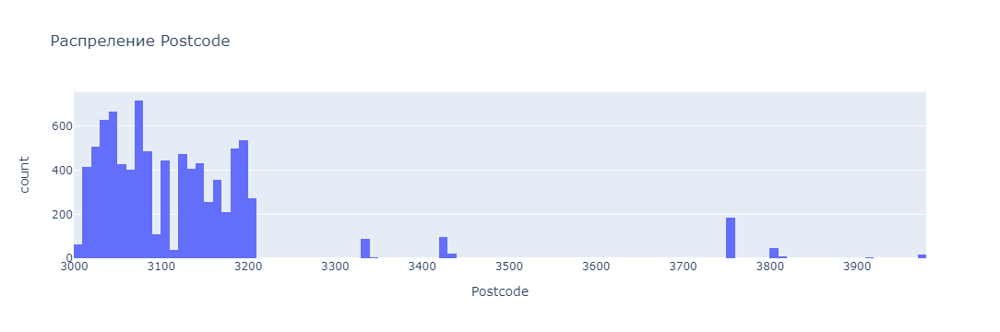

Количество строк с выбросами в столбце 'Bedroom2': 72


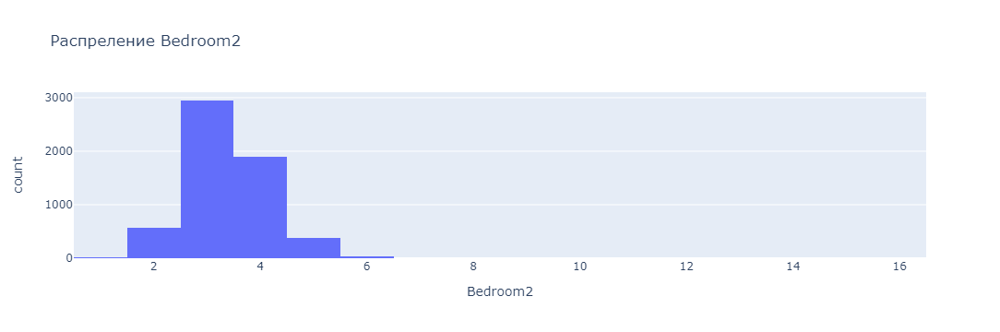

Количество строк с выбросами в столбце 'Bathroom': 83


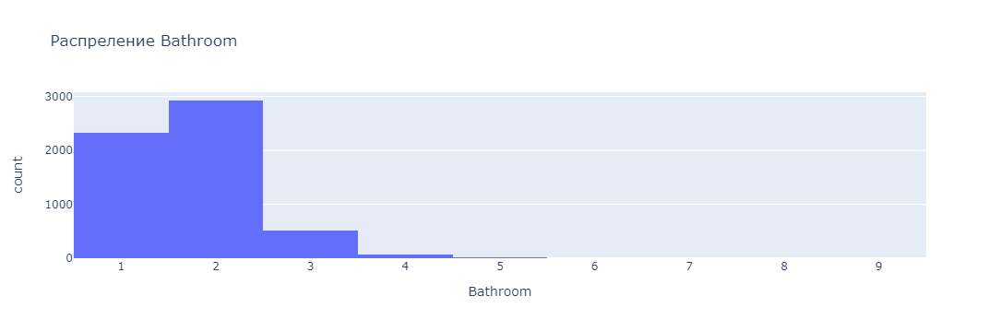

Количество строк с выбросами в столбце 'Car': 464


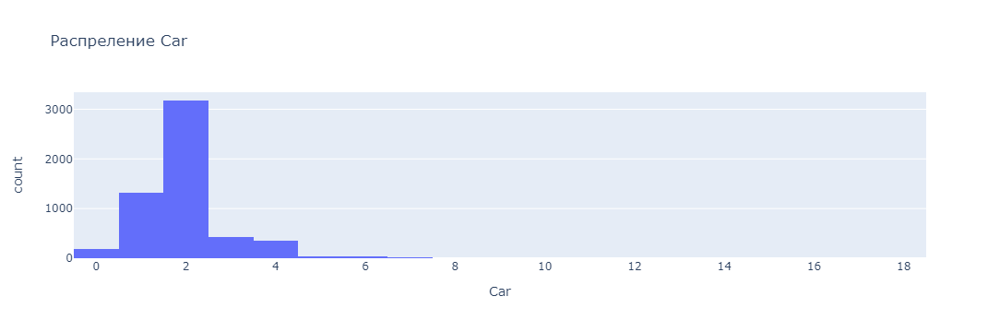

Количество строк с выбросами в столбце 'Landsize': 118


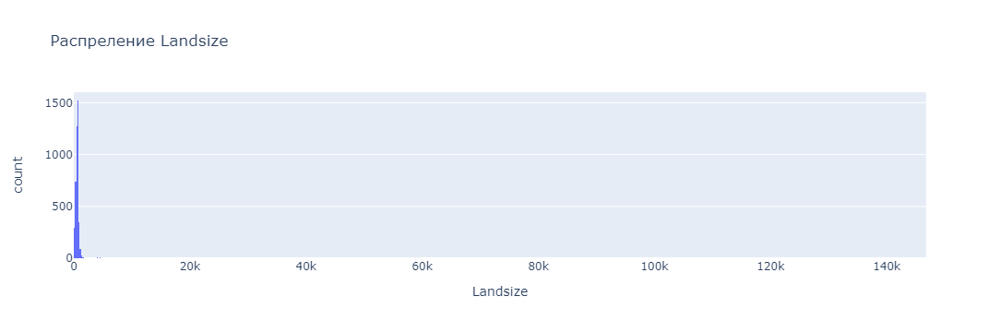

Количество строк с выбросами в столбце 'BuildingArea': 135


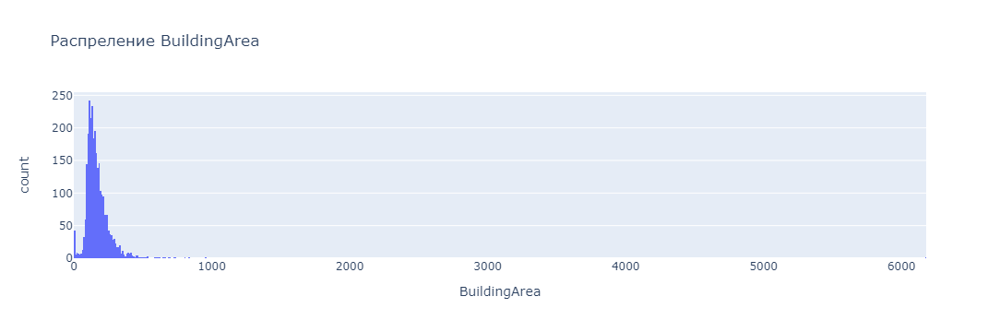

Количество строк с выбросами в столбце 'YearBuilt': 7


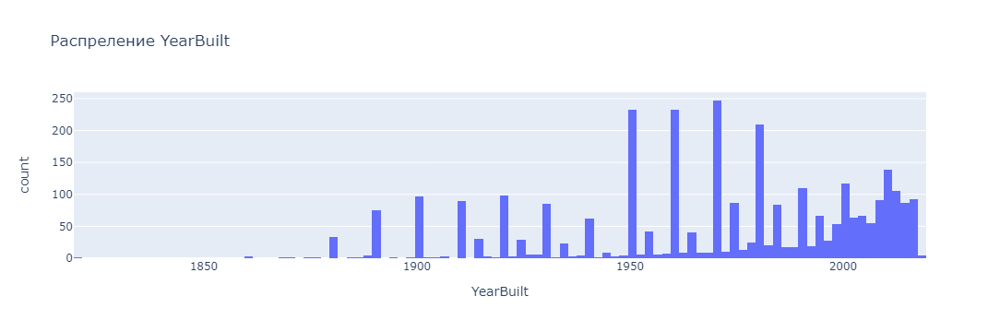

Количество уникальных значений в столбце 'CouncilArea': 33
Уникальные значения в столбце 'CouncilArea':
['Yarra City Council' 'Moonee Valley City Council' 'Brimbank City Council'
 'Hobsons Bay City Council' 'Moorabool Shire Council'
 'Port Phillip City Council' 'Boroondara City Council'
 'Bayside City Council' 'Banyule City Council' 'Glen Eira City Council'
 'Casey City Council' 'Whitehorse City Council' 'Knox City Council'
 'Hume City Council' 'Moreland City Council' 'Monash City Council'
 'Melbourne City Council' 'Kingston City Council'
 'Yarra Ranges Shire Council' 'Darebin City Council'
 'Maroondah City Council' 'Greater Dandenong City Council'
 'Manningham City Council' 'Whittlesea City Council'
 'Maribyrnong City Council' 'Frankston City Council'
 'Macedon Ranges Shire Council' 'Wyndham City Council'
 'Stonnington City Council' 'Melton City Council' 'Cardinia Shire Council'
 'Nillumbik Shire Council' 'Mitchell Shire Council' nan]


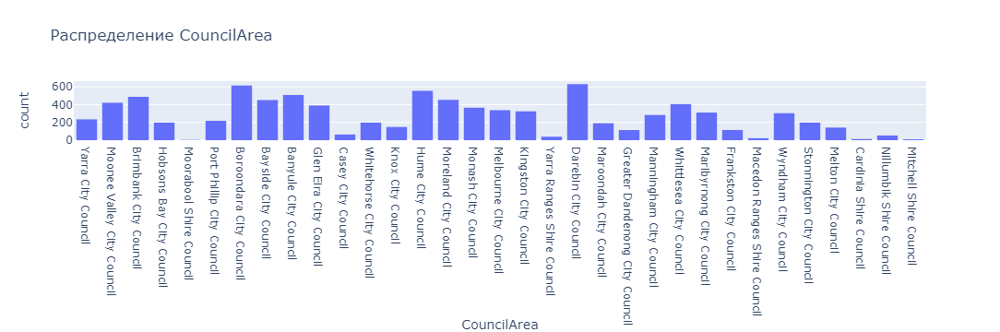

Количество строк с выбросами в столбце 'Lattitude': 256


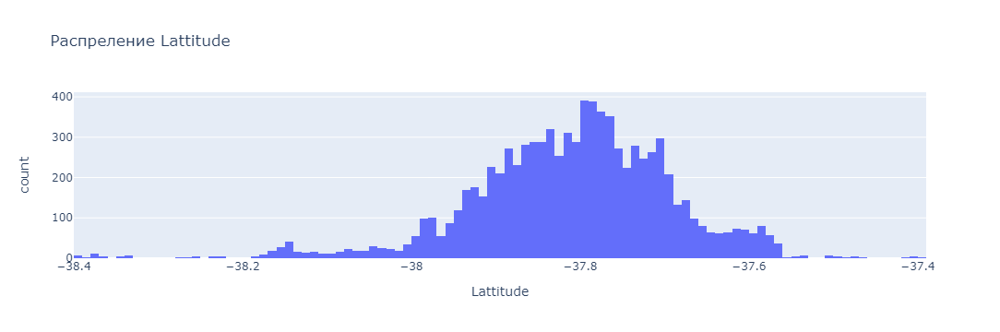

Количество строк с выбросами в столбце 'Longtitude': 298


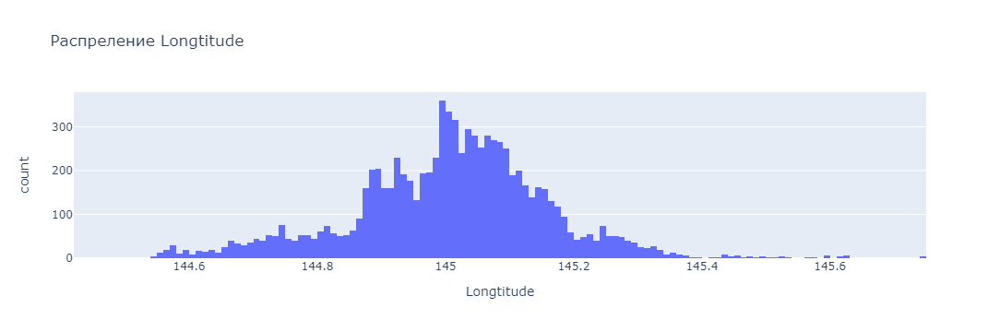

Количество уникальных значений в столбце 'Regionname': 8
Уникальные значения в столбце 'Regionname':
['Northern Metropolitan' 'Western Metropolitan' 'Western Victoria'
 'Southern Metropolitan' 'Eastern Metropolitan' 'Eastern Victoria'
 'South-Eastern Metropolitan' 'Northern Victoria' nan]


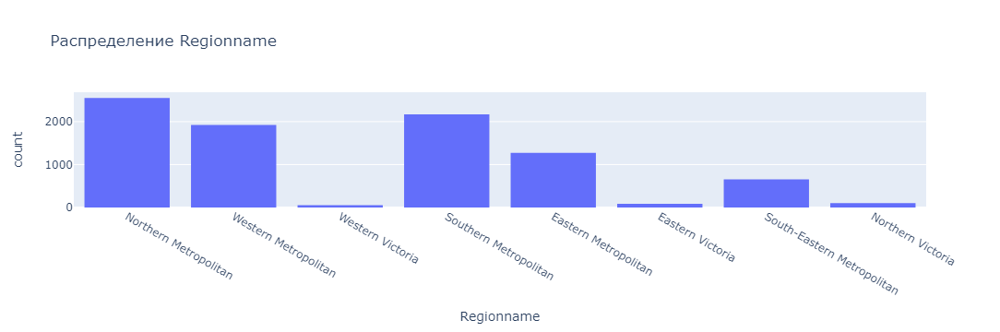

Количество строк с выбросами в столбце 'Propertycount': 185


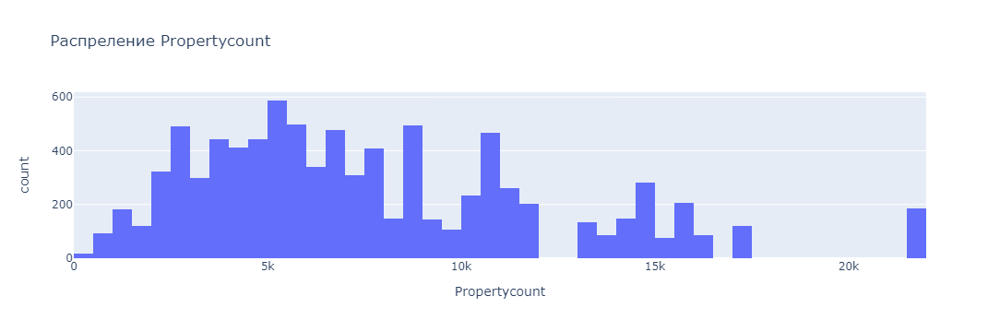

Количество строк с выбросами в столбце 'id': 0


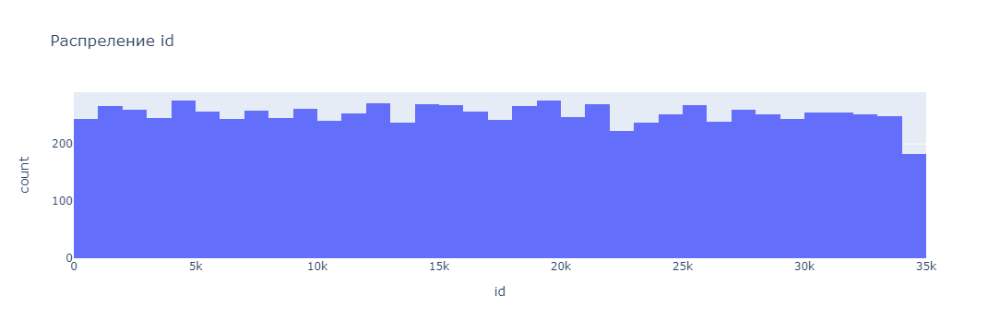

In [19]:
analyze_df(test)

Выбросы не критичны, распределение по колличеству комнат близкое к нормальному, нужно исправить странные данные с площадью объектов

#### 3. Подготовка данных

Сделаем более вменяемый признак из адреса оставив только улицу 

In [20]:
def clean_address(address):
    cleaned = re.sub(r'[0-9,/:\\]', '', address)
    cleaned = re.sub(r'\b\w{1,2}\b', '', cleaned)  
    cleaned = re.sub(r'\s+', ' ', cleaned)  
    cleaned = cleaned.strip()
    return cleaned

In [21]:
df['Address'] = df['Address'].apply(clean_address)

In [22]:
test['Address'] = test['Address'].apply(clean_address)

In [23]:
def wrong_values(df):
    df.loc[df['BuildingArea'] < 25 , 'BuildingArea'] = np.nan
    df.loc[df['Rooms'] < 1 , 'Rooms'] = np.nan
    return df

In [24]:
df = wrong_values(df)

In [25]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Rooms,18373.0,2.936592e+00,0.955952,1.000000,2.000000,3.000000,3.000000e+00,1.200000e+01
Price,18373.0,1.053235e+06,621797.251963,227000.000000,635000.000000,880000.000000,1.301000e+06,5.580000e+06
Distance,18373.0,1.040396e+01,6.018424,0.000000,6.300000,9.700000,1.330000e+01,4.810000e+01
Postcode,18373.0,3.107258e+03,95.285542,3000.000000,3046.000000,3085.000000,3.149000e+03,3.978000e+03
Bedroom2,14905.0,2.914928e+00,0.962743,0.000000,2.000000,3.000000,3.000000e+00,2.000000e+01
Bathroom,14903.0,1.538683e+00,0.688374,0.000000,1.000000,1.000000,2.000000e+00,8.000000e+00
Car,14798.0,1.617313e+00,0.957072,0.000000,1.000000,2.000000,2.000000e+00,1.000000e+01
Landsize,13579.0,5.589374e+02,3991.516323,0.000000,177.000000,440.000000,6.510000e+02,4.330140e+05
BuildingArea,7637.0,1.532801e+02,523.044641,25.000000,94.000000,127.000000,1.750000e+02,4.451500e+04
YearBuilt,8944.0,1.965925e+03,36.958956,1196.000000,1950.000000,1970.000000,2.000000e+03,2.018000e+03


Теперь лучше. Странные данные заменили на nan для последующего заполнения, адрес превратили в рабочий признак.

In [26]:
test = wrong_values(test)

Теперь заполним пропуски. Будем поэтапно заполнять с группировкой по столбцам , что бы получить более правильные значения

In [27]:
def s_missing(df):
    s_list = ['Address']

    for col in df.columns:
        if df[col].dtype == 'object':
            df[col].fillna(df.groupby(s_list)[col].transform(lambda x: x.mode()[0]), inplace=True)
        else:
            df[col].fillna(df.groupby(s_list)[col].transform('median'), inplace=True)
    
    return df

In [28]:
def a_missing(df):
    a_list = ['Suburb', 'Postcode', 'Type', 'Rooms']

    for col in df.columns:
        if df[col].dtype == 'object':
            df[col].fillna(df.groupby(a_list)[col].transform(lambda x: x.mode()[0]), inplace=True)
        else:
            df[col].fillna(df.groupby(a_list)[col].transform('median'), inplace=True)
    
    return df

In [29]:
def b_missing(df):
    b_list = ['Postcode', 'Type', 'Rooms']

    for col in df.columns:
        if df[col].dtype == 'object':
             df[col].fillna(df.groupby(b_list)[col].transform(lambda x: x.mode()[0]), inplace=True)
        else:
            df[col].fillna(df.groupby(b_list)[col].transform('median'), inplace=True)
    
    return df

In [30]:
def c_missing(df):
    c_list = ['CouncilArea' , 'Type', 'Rooms']

    for col in df.columns:
         if df[col].dtype == 'object':
             df[col].fillna(df.groupby(c_list)[col].transform(lambda x: x.mode()[0]), inplace=True)
         else:
            df[col].fillna(df.groupby(c_list)[col].transform('median'), inplace=True)
    
    return df

In [31]:
def d_missing(df):
    d_list = ['Regionname' , 'Type', 'Rooms']

    for col in df.columns:
        if df[col].dtype == 'object':
             df[col].fillna(df.groupby(d_list)[col].transform(lambda x: x.mode()[0]), inplace=True)
        else:
            df[col].fillna(df.groupby(d_list)[col].transform('median'), inplace=True)
    
    return df

In [32]:
def f_missing(df):
    f_list = ['Type']

    for col in df.columns:
        if df[col].dtype == 'object':
            df[col].fillna(df.groupby(f_list)[col].transform(lambda x: x.mode()[0]), inplace=True)
        else:
            df[col].fillna(df.groupby(f_list)[col].transform('median'), inplace=True)
    
    return df

In [33]:
df = s_missing(df)
df = a_missing(df)
df = b_missing(df)
df = c_missing(df)
df = d_missing(df)
df = f_missing(df)

In [34]:
test = s_missing(test)
test = a_missing(test)
test = b_missing(test)
test = c_missing(test)
test = d_missing(test)
test = f_missing(test)

In [35]:
df.isna().sum()

Suburb           0
Address          0
Rooms            0
Type             0
Price            0
Method           0
SellerG          0
Date             0
Distance         0
Postcode         0
Bedroom2         0
Bathroom         0
Car              0
Landsize         0
BuildingArea     0
YearBuilt        0
CouncilArea      0
Lattitude        0
Longtitude       0
Regionname       0
Propertycount    0
id               0
dtype: int64

In [36]:
test.isna().sum()

Suburb           0
Address          0
Rooms            0
Type             0
Method           0
SellerG          0
Date             0
Distance         0
Postcode         0
Bedroom2         0
Bathroom         0
Car              0
Landsize         0
BuildingArea     0
YearBuilt        0
CouncilArea      0
Lattitude        0
Longtitude       0
Regionname       0
Propertycount    0
id               0
dtype: int64

In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18373 entries, 0 to 18372
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         18373 non-null  object 
 1   Address        18373 non-null  object 
 2   Rooms          18373 non-null  float64
 3   Type           18373 non-null  object 
 4   Price          18373 non-null  float64
 5   Method         18373 non-null  object 
 6   SellerG        18373 non-null  object 
 7   Date           18373 non-null  object 
 8   Distance       18373 non-null  float64
 9   Postcode       18373 non-null  float64
 10  Bedroom2       18373 non-null  float64
 11  Bathroom       18373 non-null  float64
 12  Car            18373 non-null  float64
 13  Landsize       18373 non-null  float64
 14  BuildingArea   18373 non-null  float64
 15  YearBuilt      18373 non-null  float64
 16  CouncilArea    18373 non-null  object 
 17  Lattitude      18373 non-null  float64
 18  Longti

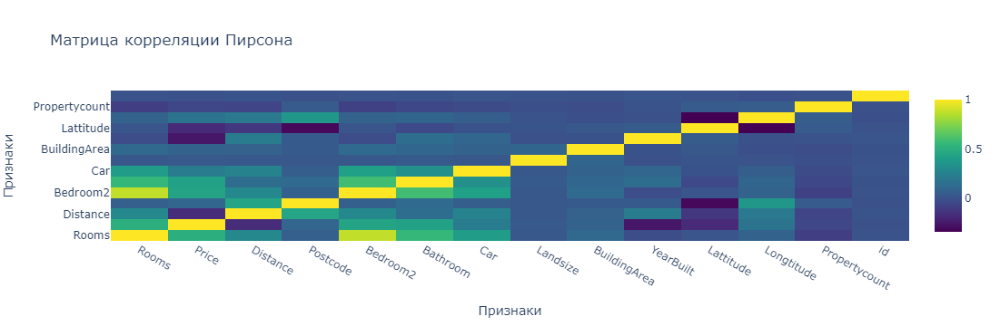

In [38]:
correlation_matrix = df.corr(numeric_only = True)

fig = go.Figure(data=go.Heatmap(
    z=correlation_matrix.values,
    x=correlation_matrix.columns,
    y=correlation_matrix.index,
    colorscale='Viridis',  
))


fig.update_layout(
    title="Матрица корреляции Пирсона",
    xaxis_title="Признаки",
    yaxis_title="Признаки"
)

fig.show()

interval columns not set, guessing: ['Rooms', 'Price', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car', 'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount', 'id']


C:\Users\solov\anaconda3\Lib\site-packages\phik\data_quality.py:59: UserWarning:

The number of unique values of variable Address is large: 5348. Are you sure this is not an interval variable? Analysis for pairs of variables including Address can be slow.



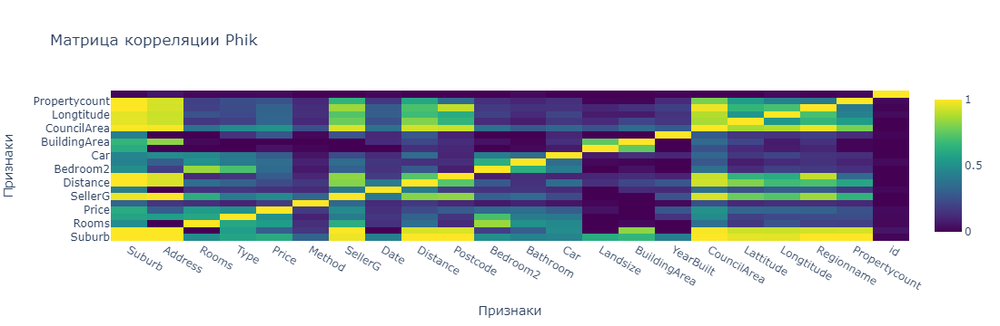

In [39]:
phik_matrix = df.phik_matrix()

fig = go.Figure(data=go.Heatmap(
    z=phik_matrix.values,
    x=phik_matrix.columns,
    y=phik_matrix.index,
    colorscale='Viridis',  
))


fig.update_layout(
    title="Матрица корреляции Phik",
    xaxis_title="Признаки",
    yaxis_title="Признаки"
)

fig.show()

Целевой признак Price имеет связь с географическими признаками и годом постройки здания, а так же достаточно высокие показатели у признака с риелтором что выглядит странно. Так же странно выглядит слабая связь с площадью объекта

In [40]:
df.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'SellerG',
       'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount', 'id'],
      dtype='object')

In [41]:
RS = 42

In [42]:
test = test.drop(['id', 'Date'], axis = 1)

In [43]:
X = df.drop(columns=['Price','id', 'Date'])  
y = df['Price']

In [44]:
num_features = X.select_dtypes(exclude=['object']).columns.tolist()
cat_features = X.select_dtypes(include=['object']).columns.tolist()

In [45]:
categorical_pipeline = Pipeline(steps=[
    ("encoder", CatBoostEncoder())
])

numeric_pipeline = Pipeline(steps=[
    ('scaler', MinMaxScaler()),
])

data_transformer = ColumnTransformer(transformers=[
    ('numerical', numeric_pipeline, num_features),
    ('categorical', categorical_pipeline, cat_features)
])

preprocessor = Pipeline(steps=[
    ('data_transformer', data_transformer),
    ('polynomial_features', PolynomialFeatures(degree=2, interaction_only=True)),
    ('feature_selection', SelectFromModel(LGBMRegressor(n_estimators = 10000, force_col_wise = True), threshold='0.5 * median'))
])

Тк много уникальных значений - будем использовать целевую кодировку CatBoost, численные масштабируем MinMax.  Признаки перемножим между собой что бы получить новые признаки и повысить метрику. На выходе отберем признаки SelectFromModel 

In [46]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=RS)

In [47]:
X_train_transformed = preprocessor.fit_transform(X_train, y_train)
X_val_transformed = preprocessor.transform(X_val)
test_transformed = preprocessor.transform(test)

[LightGBM] [Info] Total Bins 45855
[LightGBM] [Info] Number of data points in the train set: 14698, number of used features: 190
[LightGBM] [Info] Start training from score 1052413.155395


In [48]:
feature_names = preprocessor.named_steps['data_transformer'].get_feature_names_out()
feature_names = preprocessor.named_steps['polynomial_features'].get_feature_names_out(input_features=feature_names)
feature_names = preprocessor.named_steps['feature_selection'].get_feature_names_out()

In [49]:
X_train = pd.DataFrame(X_train_transformed, columns=feature_names)
X_val = pd.DataFrame(X_val_transformed, columns=feature_names)
test = pd.DataFrame(test_transformed, columns=feature_names)

In [50]:
print(X_train.info())
print(X_val.info())
print(test.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14698 entries, 0 to 14697
Columns: 166 entries, x9 to x190
dtypes: float64(166)
memory usage: 18.6 MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3675 entries, 0 to 3674
Columns: 166 entries, x9 to x190
dtypes: float64(166)
memory usage: 4.7 MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8818 entries, 0 to 8817
Columns: 166 entries, x9 to x190
dtypes: float64(166)
memory usage: 11.2 MB
None


#### 4. ML

Подберем параметры для LGBM (CatBoost очень долго подбирает параметры метрики сопоставимы) 

In [53]:
def objective_lgbm(trial):
    param = {
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 10000, 15000),
        'num_leaves': trial.suggest_int('num_leaves', 31, 128),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 20),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.001, 10.0),
        'random_state': RS,
        'objective': 'regression',
        'n_jobs': -1,
        'force_col_wise': True,
    }

    kf = KFold(n_splits=5, shuffle=True, random_state=RS)
    mape_scores = []

    for train_index, valid_index in kf.split(X_train):
        X_tr, X_val = X_train.iloc[train_index], X_train.iloc[valid_index]
        y_tr, y_val = y_train.iloc[train_index], y_train.iloc[valid_index]

        model = LGBMRegressor(**param)

        model.fit(
            X_tr, y_tr,
            eval_set=[(X_val, y_val)],
            eval_metric='mape',
            callbacks=[early_stopping(stopping_rounds=300)],
        )

        preds = model.predict(X_val)
        mape_score = mean_absolute_percentage_error(y_val, preds)
        mape_scores.append(mape_score)

    return np.mean(mape_scores)

In [54]:
sampler = optuna.samplers.TPESampler(seed=RS)
study_lgbm = optuna.create_study(direction='minimize', sampler=sampler)
study_lgbm.optimize(objective_lgbm, n_trials=100)
best_params_lgbm = study_lgbm.best_params

[I 2024-06-01 12:11:32,377] A new study created in memory with name: no-name-6b8780e3-e1f9-480a-b6fa-f37c63468812


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[306]	valid_0's mape: 0.159643	valid_0's l2: 7.54068e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[749]	valid_0's mape: 0.154189	valid_0's l2: 7.8235e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[531]	valid_0's mape: 0.160654	v

[I 2024-06-01 12:16:46,170] Trial 0 finished with value: 0.15925585134391923 and parameters: {'learning_rate': 0.03807947176588889, 'n_estimators': 14754, 'num_leaves': 102, 'min_child_samples': 14, 'subsample': 0.5780093202212182, 'reg_lambda': 1.5607892088416901}. Best is trial 0 with value: 0.15925585134391923.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1881]	valid_0's mape: 0.159646	valid_0's l2: 7.76232e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2282]	valid_0's mape: 0.154983	valid_0's l2: 7.94319e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2120]	valid_0's mape: 0.1612

[I 2024-06-01 12:23:39,572] Trial 1 finished with value: 0.159003717923446 and parameters: {'learning_rate': 0.006750277604651747, 'n_estimators': 14331, 'num_leaves': 89, 'min_child_samples': 16, 'subsample': 0.5102922471479012, 'reg_lambda': 9.699128611767781}. Best is trial 1 with value: 0.159003717923446.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[340]	valid_0's mape: 0.158274	valid_0's l2: 7.52264e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[580]	valid_0's mape: 0.154751	valid_0's l2: 7.8624e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[352]	valid_0's mape: 0.161592	v

[I 2024-06-01 12:24:42,518] Trial 2 finished with value: 0.15983735848746666 and parameters: {'learning_rate': 0.08341182143924175, 'n_estimators': 11061, 'num_leaves': 48, 'min_child_samples': 7, 'subsample': 0.6521211214797689, 'reg_lambda': 5.2480395598907466}. Best is trial 1 with value: 0.159003717923446.


Early stopping, best iteration is:
[510]	valid_0's mape: 0.161466	valid_0's l2: 8.06622e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[544]	valid_0's mape: 0.15828	valid_0's l2: 7.56733e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[517]	valid_0's mape: 0.153647	valid_0's l2: 7.85686e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don'

[I 2024-06-01 12:27:03,988] Trial 3 finished with value: 0.1584557622235982 and parameters: {'learning_rate': 0.04376255684556946, 'n_estimators': 11456, 'num_leaves': 90, 'min_child_samples': 7, 'subsample': 0.6460723242676091, 'reg_lambda': 3.6642520710936233}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[738]	valid_0's mape: 0.158606	valid_0's l2: 7.52389e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[768]	valid_0's mape: 0.154474	valid_0's l2: 7.73218e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[778]	valid_0's mape: 0.161811	

[I 2024-06-01 12:29:05,482] Trial 4 finished with value: 0.15874961873669574 and parameters: {'learning_rate': 0.04615092843748656, 'n_estimators': 13926, 'num_leaves': 50, 'min_child_samples': 13, 'subsample': 0.7962072844310213, 'reg_lambda': 0.4654576767872573}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[501]	valid_0's mape: 0.158597	valid_0's l2: 7.66284e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[654]	valid_0's mape: 0.154875	valid_0's l2: 7.89933e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[972]	valid_0's mape: 0.161926	

[I 2024-06-01 12:30:18,045] Trial 5 finished with value: 0.15922091020806833 and parameters: {'learning_rate': 0.0611469403382424, 'n_estimators': 10852, 'num_leaves': 37, 'min_child_samples': 20, 'subsample': 0.9828160165372797, 'reg_lambda': 8.084165083816496}. Best is trial 3 with value: 0.1584557622235982.


Early stopping, best iteration is:
[705]	valid_0's mape: 0.161808	valid_0's l2: 7.85509e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[489]	valid_0's mape: 0.158804	valid_0's l2: 7.6105e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[715]	valid_0's mape: 0.153733	valid_0's l2: 8.03304e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don'

[I 2024-06-01 12:33:16,275] Trial 6 finished with value: 0.15845782330620445 and parameters: {'learning_rate': 0.0311567631481637, 'n_estimators': 10488, 'num_leaves': 98, 'min_child_samples': 12, 'subsample': 0.5610191174223894, 'reg_lambda': 4.952273924202591}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2577]	valid_0's mape: 0.160142	valid_0's l2: 7.62076e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[5079]	valid_0's mape: 0.154941	valid_0's l2: 7.89788e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[6170]	valid_0's mape: 0.1610

[I 2024-06-01 12:42:15,114] Trial 7 finished with value: 0.15876369102598428 and parameters: {'learning_rate': 0.004404463590406622, 'n_estimators': 14547, 'num_leaves': 56, 'min_child_samples': 15, 'subsample': 0.6558555380447055, 'reg_lambda': 5.201160143756931}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[257]	valid_0's mape: 0.159716	valid_0's l2: 7.87718e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[418]	valid_0's mape: 0.157691	valid_0's l2: 8.03123e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[337]	valid_0's mape: 0.162539	

[I 2024-06-01 12:44:09,569] Trial 8 finished with value: 0.16048943979838617 and parameters: {'learning_rate': 0.05512431765498469, 'n_estimators': 10924, 'num_leaves': 126, 'min_child_samples': 17, 'subsample': 0.9697494707820946, 'reg_lambda': 8.94837867692606}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[814]	valid_0's mape: 0.159384	valid_0's l2: 7.65572e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[482]	valid_0's mape: 0.155251	valid_0's l2: 7.76911e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1573]	valid_0's mape: 0.160514

[I 2024-06-01 12:45:26,279] Trial 9 finished with value: 0.15916090532970753 and parameters: {'learning_rate': 0.06019209790229743, 'n_estimators': 14610, 'num_leaves': 39, 'min_child_samples': 8, 'subsample': 0.522613644455269, 'reg_lambda': 3.25397797730188}. Best is trial 3 with value: 0.1584557622235982.


Early stopping, best iteration is:
[671]	valid_0's mape: 0.161206	valid_0's l2: 7.92349e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[301]	valid_0's mape: 0.159415	valid_0's l2: 7.6482e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[250]	valid_0's mape: 0.154487	valid_0's l2: 8.09899e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don'

[I 2024-06-01 12:46:48,356] Trial 10 finished with value: 0.15961936680727257 and parameters: {'learning_rate': 0.0945685178788083, 'n_estimators': 12312, 'num_leaves': 73, 'min_child_samples': 5, 'subsample': 0.798940533403693, 'reg_lambda': 6.902780488617884}. Best is trial 3 with value: 0.1584557622235982.


Early stopping, best iteration is:
[257]	valid_0's mape: 0.162692	valid_0's l2: 7.99224e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[783]	valid_0's mape: 0.157849	valid_0's l2: 7.49e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1126]	valid_0's mape: 0.154573	valid_0's l2: 7.90214e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't

[I 2024-06-01 12:50:19,250] Trial 11 finished with value: 0.15874037851983328 and parameters: {'learning_rate': 0.026591943070425707, 'n_estimators': 10094, 'num_leaves': 107, 'min_child_samples': 10, 'subsample': 0.6588870850630025, 'reg_lambda': 3.2451690579698176}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1067]	valid_0's mape: 0.158163	valid_0's l2: 7.60985e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1232]	valid_0's mape: 0.153727	valid_0's l2: 7.86718e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1533]	valid_0's mape: 0.1602

[I 2024-06-01 12:53:23,703] Trial 12 finished with value: 0.15845916764254525 and parameters: {'learning_rate': 0.02629369989866743, 'n_estimators': 12068, 'num_leaves': 77, 'min_child_samples': 10, 'subsample': 0.7269179481655591, 'reg_lambda': 3.375916238972555}. Best is trial 3 with value: 0.1584557622235982.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[598]	valid_0's mape: 0.158276	valid_0's l2: 7.61532e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1129]	valid_0's mape: 0.15291	valid_0's l2: 7.84958e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1184]	valid_0's mape: 0.159988

[I 2024-06-01 12:56:35,893] Trial 13 finished with value: 0.1581712437999553 and parameters: {'learning_rate': 0.02596334319130348, 'n_estimators': 10024, 'num_leaves': 95, 'min_child_samples': 11, 'subsample': 0.5925653633882709, 'reg_lambda': 6.527159321049588}. Best is trial 13 with value: 0.1581712437999553.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[222]	valid_0's mape: 0.159524	valid_0's l2: 7.95969e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[316]	valid_0's mape: 0.155294	valid_0's l2: 7.93734e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[330]	valid_0's mape: 0.161765	

[I 2024-06-01 12:58:42,675] Trial 14 finished with value: 0.1598878828102858 and parameters: {'learning_rate': 0.07503017160742388, 'n_estimators': 11733, 'num_leaves': 126, 'min_child_samples': 5, 'subsample': 0.6153617991961913, 'reg_lambda': 6.672788859175874}. Best is trial 13 with value: 0.1581712437999553.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1395]	valid_0's mape: 0.157182	valid_0's l2: 7.6408e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2298]	valid_0's mape: 0.152567	valid_0's l2: 7.79572e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2337]	valid_0's mape: 0.15984

[I 2024-06-01 13:02:51,212] Trial 15 finished with value: 0.15745883311074413 and parameters: {'learning_rate': 0.013571499556107591, 'n_estimators': 13357, 'num_leaves': 70, 'min_child_samples': 10, 'subsample': 0.7485426968054263, 'reg_lambda': 6.855360576681216}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1380]	valid_0's mape: 0.157924	valid_0's l2: 7.60238e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2108]	valid_0's mape: 0.15274	valid_0's l2: 7.89733e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1538]	valid_0's mape: 0.15991

[I 2024-06-01 13:06:43,669] Trial 16 finished with value: 0.15788532319522042 and parameters: {'learning_rate': 0.01659449728560356, 'n_estimators': 13671, 'num_leaves': 74, 'min_child_samples': 11, 'subsample': 0.8888558017534706, 'reg_lambda': 7.15578362400447}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2199]	valid_0's mape: 0.157672	valid_0's l2: 7.58735e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1785]	valid_0's mape: 0.154396	valid_0's l2: 7.80315e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3924]	valid_0's mape: 0.1590

[I 2024-06-01 13:12:39,811] Trial 17 finished with value: 0.15786488184318304 and parameters: {'learning_rate': 0.008625121606395662, 'n_estimators': 13148, 'num_leaves': 65, 'min_child_samples': 9, 'subsample': 0.8987078859478498, 'reg_lambda': 7.946658995756779}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1482]	valid_0's mape: 0.158084	valid_0's l2: 7.7036e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2002]	valid_0's mape: 0.15249	valid_0's l2: 7.81291e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2135]	valid_0's mape: 0.160417

[I 2024-06-01 13:16:27,088] Trial 18 finished with value: 0.15816367407249016 and parameters: {'learning_rate': 0.013654608103981364, 'n_estimators': 13016, 'num_leaves': 62, 'min_child_samples': 9, 'subsample': 0.8805304594988683, 'reg_lambda': 8.31499631252143}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[8299]	valid_0's mape: 0.159522	valid_0's l2: 7.64939e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Did not meet early stopping. Best iteration is:
[13095]	valid_0's mape: 0.153418	valid_0's l2: 7.74047e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[11786]	valid_0

[I 2024-06-01 13:37:41,432] Trial 19 finished with value: 0.1592040726818666 and parameters: {'learning_rate': 0.0014692718456558382, 'n_estimators': 13095, 'num_leaves': 62, 'min_child_samples': 7, 'subsample': 0.7389128700194536, 'reg_lambda': 7.710016534032549}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1674]	valid_0's mape: 0.157746	valid_0's l2: 7.6701e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1537]	valid_0's mape: 0.152932	valid_0's l2: 7.86068e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1864]	valid_0's mape: 0.15995

[I 2024-06-01 13:41:38,458] Trial 20 finished with value: 0.15769936554497083 and parameters: {'learning_rate': 0.014291644835266014, 'n_estimators': 12937, 'num_leaves': 66, 'min_child_samples': 9, 'subsample': 0.8916010535235348, 'reg_lambda': 9.527631094270514}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1423]	valid_0's mape: 0.157725	valid_0's l2: 7.65284e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1436]	valid_0's mape: 0.15305	valid_0's l2: 7.83953e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2278]	valid_0's mape: 0.15982

[I 2024-06-01 13:45:20,870] Trial 21 finished with value: 0.1577388333763409 and parameters: {'learning_rate': 0.016173768274440295, 'n_estimators': 12842, 'num_leaves': 67, 'min_child_samples': 9, 'subsample': 0.8986201716207877, 'reg_lambda': 9.930886207504884}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1340]	valid_0's mape: 0.157847	valid_0's l2: 7.73083e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1310]	valid_0's mape: 0.153064	valid_0's l2: 7.85312e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1564]	valid_0's mape: 0.1600

[I 2024-06-01 13:49:09,164] Trial 22 finished with value: 0.1578316915628311 and parameters: {'learning_rate': 0.017294030549352014, 'n_estimators': 12676, 'num_leaves': 83, 'min_child_samples': 12, 'subsample': 0.8319764882703757, 'reg_lambda': 9.876660279060994}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[878]	valid_0's mape: 0.15852	valid_0's l2: 7.65006e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2125]	valid_0's mape: 0.152346	valid_0's l2: 7.87509e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2128]	valid_0's mape: 0.159671

[I 2024-06-01 13:52:35,956] Trial 23 finished with value: 0.1578734402079538 and parameters: {'learning_rate': 0.019232489392222718, 'n_estimators': 13725, 'num_leaves': 67, 'min_child_samples': 9, 'subsample': 0.937604091004545, 'reg_lambda': 9.00166774100341}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[683]	valid_0's mape: 0.158155	valid_0's l2: 7.74729e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1138]	valid_0's mape: 0.152206	valid_0's l2: 7.69854e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1434]	valid_0's mape: 0.16011

[I 2024-06-01 13:54:47,150] Trial 24 finished with value: 0.15766690836199498 and parameters: {'learning_rate': 0.035512161214275764, 'n_estimators': 12771, 'num_leaves': 53, 'min_child_samples': 6, 'subsample': 0.8353134789290282, 'reg_lambda': 8.916839360341797}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[853]	valid_0's mape: 0.157915	valid_0's l2: 7.66332e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[892]	valid_0's mape: 0.153798	valid_0's l2: 7.71075e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1515]	valid_0's mape: 0.160187

[I 2024-06-01 13:56:44,517] Trial 25 finished with value: 0.15838761536914786 and parameters: {'learning_rate': 0.03649449657597467, 'n_estimators': 12400, 'num_leaves': 45, 'min_child_samples': 6, 'subsample': 0.8314063332863684, 'reg_lambda': 8.836252264311273}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[667]	valid_0's mape: 0.158648	valid_0's l2: 7.54002e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1334]	valid_0's mape: 0.153375	valid_0's l2: 7.74556e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1393]	valid_0's mape: 0.15949

[I 2024-06-01 13:59:00,593] Trial 26 finished with value: 0.15782651608878262 and parameters: {'learning_rate': 0.03562670387890022, 'n_estimators': 13497, 'num_leaves': 54, 'min_child_samples': 6, 'subsample': 0.7177694282992907, 'reg_lambda': 5.970849705719363}. Best is trial 15 with value: 0.15745883311074413.


Early stopping, best iteration is:
[612]	valid_0's mape: 0.160859	valid_0's l2: 7.97163e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[884]	valid_0's mape: 0.158131	valid_0's l2: 7.63502e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1626]	valid_0's mape: 0.152262	valid_0's l2: 7.76988e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores do

[I 2024-06-01 14:02:33,408] Trial 27 finished with value: 0.1577229010092817 and parameters: {'learning_rate': 0.022954144751688346, 'n_estimators': 11949, 'num_leaves': 82, 'min_child_samples': 8, 'subsample': 0.7815693233988456, 'reg_lambda': 7.38311741558247}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2367]	valid_0's mape: 0.1578	valid_0's l2: 7.63049e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3460]	valid_0's mape: 0.152824	valid_0's l2: 7.74829e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2470]	valid_0's mape: 0.1601	v

[I 2024-06-01 14:07:10,219] Trial 28 finished with value: 0.15810464687645828 and parameters: {'learning_rate': 0.010344131862368686, 'n_estimators': 13432, 'num_leaves': 56, 'min_child_samples': 11, 'subsample': 0.8353354391045295, 'reg_lambda': 9.06116252238227}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[470]	valid_0's mape: 0.158542	valid_0's l2: 7.69564e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[698]	valid_0's mape: 0.154339	valid_0's l2: 7.85933e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[429]	valid_0's mape: 0.162281	

[I 2024-06-01 14:09:25,465] Trial 29 finished with value: 0.15927333668527877 and parameters: {'learning_rate': 0.03236668591450469, 'n_estimators': 14988, 'num_leaves': 110, 'min_child_samples': 14, 'subsample': 0.6946841640957683, 'reg_lambda': 8.444054526707317}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[372]	valid_0's mape: 0.159782	valid_0's l2: 7.6183e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[570]	valid_0's mape: 0.154982	valid_0's l2: 7.73728e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[777]	valid_0's mape: 0.160814	v

[I 2024-06-01 14:10:41,039] Trial 30 finished with value: 0.15899451525099448 and parameters: {'learning_rate': 0.051951858408135626, 'n_estimators': 14052, 'num_leaves': 42, 'min_child_samples': 6, 'subsample': 0.7756816181543875, 'reg_lambda': 5.9695867994928395}. Best is trial 15 with value: 0.15745883311074413.


Early stopping, best iteration is:
[758]	valid_0's mape: 0.16049	valid_0's l2: 7.94896e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[894]	valid_0's mape: 0.157539	valid_0's l2: 7.68481e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1011]	valid_0's mape: 0.152524	valid_0's l2: 7.88021e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don

[I 2024-06-01 14:13:59,695] Trial 31 finished with value: 0.15767964415567487 and parameters: {'learning_rate': 0.022796451971504823, 'n_estimators': 11992, 'num_leaves': 80, 'min_child_samples': 8, 'subsample': 0.7622397868381492, 'reg_lambda': 7.441625181799591}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[623]	valid_0's mape: 0.158159	valid_0's l2: 7.80815e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[951]	valid_0's mape: 0.153229	valid_0's l2: 7.81548e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1115]	valid_0's mape: 0.159705

[I 2024-06-01 14:16:15,564] Trial 32 finished with value: 0.15798688514112813 and parameters: {'learning_rate': 0.04002601021605814, 'n_estimators': 12610, 'num_leaves': 69, 'min_child_samples': 8, 'subsample': 0.852953832735548, 'reg_lambda': 9.384465839197508}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2391]	valid_0's mape: 0.159495	valid_0's l2: 7.58753e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2620]	valid_0's mape: 0.154525	valid_0's l2: 7.70259e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2993]	valid_0's mape: 0.1619

[I 2024-06-01 14:19:23,447] Trial 33 finished with value: 0.15929749986544067 and parameters: {'learning_rate': 0.010349040795580494, 'n_estimators': 11508, 'num_leaves': 31, 'min_child_samples': 10, 'subsample': 0.7618440336213275, 'reg_lambda': 8.440611002858441}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[946]	valid_0's mape: 0.157526	valid_0's l2: 7.63132e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1355]	valid_0's mape: 0.152698	valid_0's l2: 7.86176e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1218]	valid_0's mape: 0.16124

[I 2024-06-01 14:23:01,734] Trial 34 finished with value: 0.15815337107131816 and parameters: {'learning_rate': 0.02272864958851745, 'n_estimators': 12167, 'num_leaves': 89, 'min_child_samples': 7, 'subsample': 0.7007952039303885, 'reg_lambda': 6.12002167538057}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[422]	valid_0's mape: 0.158094	valid_0's l2: 7.53055e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[685]	valid_0's mape: 0.154809	valid_0's l2: 7.99503e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[436]	valid_0's mape: 0.159657	

[I 2024-06-01 14:24:54,867] Trial 35 finished with value: 0.15856991783733837 and parameters: {'learning_rate': 0.045372822282163695, 'n_estimators': 13340, 'num_leaves': 83, 'min_child_samples': 8, 'subsample': 0.931244895819563, 'reg_lambda': 4.489107364341773}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[818]	valid_0's mape: 0.15878	valid_0's l2: 7.66682e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1365]	valid_0's mape: 0.152764	valid_0's l2: 7.73513e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1338]	valid_0's mape: 0.159865

[I 2024-06-01 14:27:17,123] Trial 36 finished with value: 0.15792115801280496 and parameters: {'learning_rate': 0.02988749753761134, 'n_estimators': 14061, 'num_leaves': 59, 'min_child_samples': 7, 'subsample': 0.8552406625058026, 'reg_lambda': 7.413238849570757}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[883]	valid_0's mape: 0.158738	valid_0's l2: 7.57819e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[965]	valid_0's mape: 0.155027	valid_0's l2: 7.80422e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2000]	valid_0's mape: 0.160053

[I 2024-06-01 14:30:55,113] Trial 37 finished with value: 0.15872005677639286 and parameters: {'learning_rate': 0.02053203830084737, 'n_estimators': 11305, 'num_leaves': 73, 'min_child_samples': 5, 'subsample': 0.8026309664625175, 'reg_lambda': 1.7759632106500076}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[885]	valid_0's mape: 0.1578	valid_0's l2: 7.56269e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[546]	valid_0's mape: 0.154844	valid_0's l2: 7.81712e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1122]	valid_0's mape: 0.160447	v

[I 2024-06-01 14:32:40,397] Trial 38 finished with value: 0.15822697246601175 and parameters: {'learning_rate': 0.039410583744172924, 'n_estimators': 12785, 'num_leaves': 52, 'min_child_samples': 13, 'subsample': 0.7507241626797694, 'reg_lambda': 9.444624550014929}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1245]	valid_0's mape: 0.159913	valid_0's l2: 7.69541e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2746]	valid_0's mape: 0.154505	valid_0's l2: 7.86213e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3304]	valid_0's mape: 0.1602

[I 2024-06-01 14:39:32,984] Trial 39 finished with value: 0.15893165593263664 and parameters: {'learning_rate': 0.007345268812620905, 'n_estimators': 11833, 'num_leaves': 90, 'min_child_samples': 17, 'subsample': 0.9269058490618016, 'reg_lambda': 7.72193707634557}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[4196]	valid_0's mape: 0.160717	valid_0's l2: 7.63001e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[4273]	valid_0's mape: 0.156326	valid_0's l2: 7.86766e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[7026]	valid_0's mape: 0.1610

[I 2024-06-01 14:49:16,583] Trial 40 finished with value: 0.15911994187914733 and parameters: {'learning_rate': 0.0034466358616499805, 'n_estimators': 14293, 'num_leaves': 49, 'min_child_samples': 10, 'subsample': 0.6828195259101368, 'reg_lambda': 5.516387878638543}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1164]	valid_0's mape: 0.157611	valid_0's l2: 7.63604e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1149]	valid_0's mape: 0.152972	valid_0's l2: 7.80221e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1767]	valid_0's mape: 0.1596

[I 2024-06-01 14:52:34,031] Trial 41 finished with value: 0.1576543914055907 and parameters: {'learning_rate': 0.021976788078651086, 'n_estimators': 11904, 'num_leaves': 70, 'min_child_samples': 8, 'subsample': 0.7809642001738858, 'reg_lambda': 7.1610646999049825}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1597]	valid_0's mape: 0.157944	valid_0's l2: 7.6624e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2118]	valid_0's mape: 0.151704	valid_0's l2: 7.75786e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1683]	valid_0's mape: 0.16040

[I 2024-06-01 14:57:23,891] Trial 42 finished with value: 0.1577339705230519 and parameters: {'learning_rate': 0.011903256774549927, 'n_estimators': 12488, 'num_leaves': 76, 'min_child_samples': 6, 'subsample': 0.8107371168752, 'reg_lambda': 8.64906437565017}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[555]	valid_0's mape: 0.158231	valid_0's l2: 7.65413e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1046]	valid_0's mape: 0.152477	valid_0's l2: 7.79242e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1560]	valid_0's mape: 0.15927

[I 2024-06-01 14:59:54,066] Trial 43 finished with value: 0.15785947350675894 and parameters: {'learning_rate': 0.02975536479137711, 'n_estimators': 12270, 'num_leaves': 71, 'min_child_samples': 8, 'subsample': 0.7710650546415438, 'reg_lambda': 8.013684734374472}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[972]	valid_0's mape: 0.157545	valid_0's l2: 7.50376e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1752]	valid_0's mape: 0.153672	valid_0's l2: 7.90017e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1547]	valid_0's mape: 0.15977

[I 2024-06-01 15:03:10,630] Trial 44 finished with value: 0.15780657804249257 and parameters: {'learning_rate': 0.023002463584567902, 'n_estimators': 11544, 'num_leaves': 62, 'min_child_samples': 7, 'subsample': 0.8622572706831467, 'reg_lambda': 4.497605851683594}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[613]	valid_0's mape: 0.157657	valid_0's l2: 7.58733e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[886]	valid_0's mape: 0.152359	valid_0's l2: 7.77818e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[554]	valid_0's mape: 0.16096	v

[I 2024-06-01 15:05:22,534] Trial 45 finished with value: 0.15794949180872062 and parameters: {'learning_rate': 0.033223586028419724, 'n_estimators': 11227, 'num_leaves': 78, 'min_child_samples': 9, 'subsample': 0.995130148786207, 'reg_lambda': 6.93046920813527}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[290]	valid_0's mape: 0.160253	valid_0's l2: 7.7239e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[607]	valid_0's mape: 0.155497	valid_0's l2: 8.03985e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[703]	valid_0's mape: 0.161534	v

[I 2024-06-01 15:07:10,909] Trial 46 finished with value: 0.1593951433538106 and parameters: {'learning_rate': 0.04134620126243496, 'n_estimators': 12944, 'num_leaves': 85, 'min_child_samples': 20, 'subsample': 0.8171231803774744, 'reg_lambda': 6.467587809522517}. Best is trial 15 with value: 0.15745883311074413.


Early stopping, best iteration is:
[499]	valid_0's mape: 0.162661	valid_0's l2: 8.06226e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1959]	valid_0's mape: 0.157794	valid_0's l2: 7.65519e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1837]	valid_0's mape: 0.153739	valid_0's l2: 7.85691e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores d

[I 2024-06-01 15:10:51,289] Trial 47 finished with value: 0.15814555806255956 and parameters: {'learning_rate': 0.014563137980723687, 'n_estimators': 11747, 'num_leaves': 59, 'min_child_samples': 12, 'subsample': 0.7887128050486399, 'reg_lambda': 9.484664827251338}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[352]	valid_0's mape: 0.157968	valid_0's l2: 7.61449e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[376]	valid_0's mape: 0.154106	valid_0's l2: 7.82079e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[472]	valid_0's mape: 0.159649	

[I 2024-06-01 15:12:12,575] Trial 48 finished with value: 0.1591980073628753 and parameters: {'learning_rate': 0.0665687852825998, 'n_estimators': 10698, 'num_leaves': 78, 'min_child_samples': 11, 'subsample': 0.7230033129433443, 'reg_lambda': 5.531095746929948}. Best is trial 15 with value: 0.15745883311074413.


Early stopping, best iteration is:
[182]	valid_0's mape: 0.165138	valid_0's l2: 8.28158e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[652]	valid_0's mape: 0.158451	valid_0's l2: 7.61676e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[968]	valid_0's mape: 0.153681	valid_0's l2: 7.74357e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don

[I 2024-06-01 15:14:05,586] Trial 49 finished with value: 0.15812224624961124 and parameters: {'learning_rate': 0.028863228487431124, 'n_estimators': 12494, 'num_leaves': 45, 'min_child_samples': 10, 'subsample': 0.7507273187957294, 'reg_lambda': 7.519358185563504}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[714]	valid_0's mape: 0.157764	valid_0's l2: 7.76515e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1007]	valid_0's mape: 0.152507	valid_0's l2: 7.83214e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1045]	valid_0's mape: 0.16020

[I 2024-06-01 15:17:17,309] Trial 50 finished with value: 0.15776838910214094 and parameters: {'learning_rate': 0.0255090970762509, 'n_estimators': 13247, 'num_leaves': 95, 'min_child_samples': 7, 'subsample': 0.6395112161133885, 'reg_lambda': 8.269449370326338}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1443]	valid_0's mape: 0.15786	valid_0's l2: 7.61717e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1546]	valid_0's mape: 0.153071	valid_0's l2: 7.80232e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1733]	valid_0's mape: 0.16039

[I 2024-06-01 15:21:30,679] Trial 51 finished with value: 0.15796008847522897 and parameters: {'learning_rate': 0.01909702950367763, 'n_estimators': 11991, 'num_leaves': 83, 'min_child_samples': 8, 'subsample': 0.7819266836950555, 'reg_lambda': 7.291432639160388}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1062]	valid_0's mape: 0.1584	valid_0's l2: 7.67022e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1183]	valid_0's mape: 0.152673	valid_0's l2: 7.79456e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1945]	valid_0's mape: 0.16061	

[I 2024-06-01 15:24:43,831] Trial 52 finished with value: 0.15787861744778892 and parameters: {'learning_rate': 0.021594222679756553, 'n_estimators': 11969, 'num_leaves': 70, 'min_child_samples': 8, 'subsample': 0.736900854536388, 'reg_lambda': 6.837452121544989}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1305]	valid_0's mape: 0.157461	valid_0's l2: 7.61965e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1845]	valid_0's mape: 0.151557	valid_0's l2: 7.82869e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1848]	valid_0's mape: 0.1612

[I 2024-06-01 15:29:17,048] Trial 53 finished with value: 0.15794197014768394 and parameters: {'learning_rate': 0.014738124436109832, 'n_estimators': 12252, 'num_leaves': 80, 'min_child_samples': 6, 'subsample': 0.8789603149428171, 'reg_lambda': 6.369064143784166}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2235]	valid_0's mape: 0.1587	valid_0's l2: 7.63452e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2408]	valid_0's mape: 0.154485	valid_0's l2: 7.79823e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[4388]	valid_0's mape: 0.160119

[I 2024-06-01 15:35:50,700] Trial 54 finished with value: 0.15839349321825852 and parameters: {'learning_rate': 0.006595457784123172, 'n_estimators': 12732, 'num_leaves': 64, 'min_child_samples': 9, 'subsample': 0.8201299210710771, 'reg_lambda': 7.8111979557399565}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[219]	valid_0's mape: 0.16141	valid_0's l2: 8.0146e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[532]	valid_0's mape: 0.154058	valid_0's l2: 7.78857e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[418]	valid_0's mape: 0.161983	va

[I 2024-06-01 15:37:12,515] Trial 55 finished with value: 0.16020435186287224 and parameters: {'learning_rate': 0.09633199400919659, 'n_estimators': 11876, 'num_leaves': 74, 'min_child_samples': 7, 'subsample': 0.7921792229040587, 'reg_lambda': 7.080651157889978}. Best is trial 15 with value: 0.15745883311074413.


Early stopping, best iteration is:
[247]	valid_0's mape: 0.163472	valid_0's l2: 8.23469e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[469]	valid_0's mape: 0.159858	valid_0's l2: 7.81366e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[957]	valid_0's mape: 0.156043	valid_0's l2: 8.06202e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don

[I 2024-06-01 15:39:35,973] Trial 56 finished with value: 0.16004509578415305 and parameters: {'learning_rate': 0.024982086265547605, 'n_estimators': 11646, 'num_leaves': 102, 'min_child_samples': 19, 'subsample': 0.7643513387947933, 'reg_lambda': 9.08410947943046}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1208]	valid_0's mape: 0.158138	valid_0's l2: 7.58931e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1439]	valid_0's mape: 0.153696	valid_0's l2: 7.82975e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1557]	valid_0's mape: 0.1602

[I 2024-06-01 15:43:39,221] Trial 57 finished with value: 0.1581202549488714 and parameters: {'learning_rate': 0.018371518219548327, 'n_estimators': 13698, 'num_leaves': 86, 'min_child_samples': 8, 'subsample': 0.8443517830414222, 'reg_lambda': 2.462504005551998}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[143]	valid_0's mape: 0.160232	valid_0's l2: 7.6508e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[397]	valid_0's mape: 0.155658	valid_0's l2: 7.88156e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[353]	valid_0's mape: 0.161924	v

[I 2024-06-01 15:44:35,532] Trial 58 finished with value: 0.1605208956758815 and parameters: {'learning_rate': 0.08703096629782447, 'n_estimators': 12146, 'num_leaves': 57, 'min_child_samples': 10, 'subsample': 0.915717836446106, 'reg_lambda': 8.66600389357402}. Best is trial 15 with value: 0.15745883311074413.


Early stopping, best iteration is:
[284]	valid_0's mape: 0.164324	valid_0's l2: 8.30778e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[558]	valid_0's mape: 0.161017	valid_0's l2: 7.59762e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[712]	valid_0's mape: 0.154529	valid_0's l2: 7.72999e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don

[I 2024-06-01 15:46:25,421] Trial 59 finished with value: 0.1600170080799689 and parameters: {'learning_rate': 0.050067780220891735, 'n_estimators': 12920, 'num_leaves': 66, 'min_child_samples': 5, 'subsample': 0.6844857869907903, 'reg_lambda': 0.09382249475470861}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[523]	valid_0's mape: 0.159367	valid_0's l2: 7.73459e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[853]	valid_0's mape: 0.152056	valid_0's l2: 7.86622e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1074]	valid_0's mape: 0.15979	

[I 2024-06-01 15:48:47,601] Trial 60 finished with value: 0.15801352491203435 and parameters: {'learning_rate': 0.03607157240596078, 'n_estimators': 11088, 'num_leaves': 80, 'min_child_samples': 9, 'subsample': 0.7074701041203516, 'reg_lambda': 8.127276844332382}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2585]	valid_0's mape: 0.158323	valid_0's l2: 7.68324e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2135]	valid_0's mape: 0.151426	valid_0's l2: 7.75535e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3239]	valid_0's mape: 0.1593

[I 2024-06-01 15:54:25,326] Trial 61 finished with value: 0.15773092400026514 and parameters: {'learning_rate': 0.012289844989879166, 'n_estimators': 12548, 'num_leaves': 74, 'min_child_samples': 6, 'subsample': 0.9585138889747563, 'reg_lambda': 9.996365266900611}. Best is trial 15 with value: 0.15745883311074413.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1815]	valid_0's mape: 0.156817	valid_0's l2: 7.69819e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1934]	valid_0's mape: 0.152582	valid_0's l2: 7.87619e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2691]	valid_0's mape: 0.1587

[I 2024-06-01 15:58:57,465] Trial 62 finished with value: 0.15726324178129902 and parameters: {'learning_rate': 0.01365880750979962, 'n_estimators': 13150, 'num_leaves': 69, 'min_child_samples': 6, 'subsample': 0.9510040667254912, 'reg_lambda': 9.99162041438721}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3261]	valid_0's mape: 0.158841	valid_0's l2: 7.74109e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[4628]	valid_0's mape: 0.152959	valid_0's l2: 7.84367e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[7292]	valid_0's mape: 0.1589

[I 2024-06-01 16:09:27,546] Trial 63 finished with value: 0.1580604123764934 and parameters: {'learning_rate': 0.0040622981295388005, 'n_estimators': 13188, 'num_leaves': 68, 'min_child_samples': 5, 'subsample': 0.9483160108487995, 'reg_lambda': 9.632242567896386}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[836]	valid_0's mape: 0.158364	valid_0's l2: 7.78937e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1531]	valid_0's mape: 0.152863	valid_0's l2: 7.75269e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1220]	valid_0's mape: 0.15992

[I 2024-06-01 16:12:09,179] Trial 64 finished with value: 0.15791329950759592 and parameters: {'learning_rate': 0.027482608952397087, 'n_estimators': 13049, 'num_leaves': 63, 'min_child_samples': 7, 'subsample': 0.9778299327929383, 'reg_lambda': 9.063629590825053}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1394]	valid_0's mape: 0.158704	valid_0's l2: 7.80198e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2977]	valid_0's mape: 0.152206	valid_0's l2: 7.81057e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3437]	valid_0's mape: 0.1596

[I 2024-06-01 16:19:10,138] Trial 65 finished with value: 0.1578169186322369 and parameters: {'learning_rate': 0.009117542254090338, 'n_estimators': 13541, 'num_leaves': 93, 'min_child_samples': 8, 'subsample': 0.8754213544411398, 'reg_lambda': 9.423667920261291}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1214]	valid_0's mape: 0.15853	valid_0's l2: 7.68462e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1732]	valid_0's mape: 0.15267	valid_0's l2: 7.70901e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1874]	valid_0's mape: 0.159967

[I 2024-06-01 16:22:48,564] Trial 66 finished with value: 0.15762264156353062 and parameters: {'learning_rate': 0.017003979508034877, 'n_estimators': 12360, 'num_leaves': 71, 'min_child_samples': 9, 'subsample': 0.8987154393284189, 'reg_lambda': 8.698159406662292}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1269]	valid_0's mape: 0.157809	valid_0's l2: 7.73617e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1188]	valid_0's mape: 0.153721	valid_0's l2: 7.87869e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1936]	valid_0's mape: 0.1593

[I 2024-06-01 16:26:30,648] Trial 67 finished with value: 0.1578889408729992 and parameters: {'learning_rate': 0.015430336278583562, 'n_estimators': 12377, 'num_leaves': 71, 'min_child_samples': 9, 'subsample': 0.9104107364571506, 'reg_lambda': 8.739838847335083}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1028]	valid_0's mape: 0.158007	valid_0's l2: 7.63392e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2329]	valid_0's mape: 0.152752	valid_0's l2: 7.85359e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1616]	valid_0's mape: 0.1601

[I 2024-06-01 16:29:36,955] Trial 68 finished with value: 0.1579387853815207 and parameters: {'learning_rate': 0.018141676455317012, 'n_estimators': 13881, 'num_leaves': 59, 'min_child_samples': 11, 'subsample': 0.8937503738930664, 'reg_lambda': 9.785559873146465}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3006]	valid_0's mape: 0.158198	valid_0's l2: 7.59386e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3113]	valid_0's mape: 0.154079	valid_0's l2: 7.84408e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[6358]	valid_0's mape: 0.1599

[I 2024-06-01 16:36:21,136] Trial 69 finished with value: 0.15811062835224426 and parameters: {'learning_rate': 0.006142626714696306, 'n_estimators': 12680, 'num_leaves': 53, 'min_child_samples': 12, 'subsample': 0.9093663707465699, 'reg_lambda': 9.265458598516433}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[10920]	valid_0's mape: 0.15859	valid_0's l2: 7.72458e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Did not meet early stopping. Best iteration is:
[12869]	valid_0's mape: 0.153752	valid_0's l2: 7.82465e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[12094]	valid_0

[I 2024-06-01 17:02:09,955] Trial 70 finished with value: 0.15950456466678947 and parameters: {'learning_rate': 0.0012570528952346206, 'n_estimators': 12871, 'num_leaves': 76, 'min_child_samples': 6, 'subsample': 0.865892884070014, 'reg_lambda': 8.44428669909666}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[620]	valid_0's mape: 0.157631	valid_0's l2: 7.64912e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[928]	valid_0's mape: 0.154151	valid_0's l2: 7.89645e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[637]	valid_0's mape: 0.16096	v

[I 2024-06-01 17:04:25,469] Trial 71 finished with value: 0.15864879327783088 and parameters: {'learning_rate': 0.03278609128512315, 'n_estimators': 13345, 'num_leaves': 81, 'min_child_samples': 10, 'subsample': 0.7379097630028135, 'reg_lambda': 7.495046569812374}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1200]	valid_0's mape: 0.157994	valid_0's l2: 7.66112e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1177]	valid_0's mape: 0.152492	valid_0's l2: 7.89825e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1846]	valid_0's mape: 0.1603

[I 2024-06-01 17:07:28,668] Trial 72 finished with value: 0.15792209204309807 and parameters: {'learning_rate': 0.02302701559888643, 'n_estimators': 12105, 'num_leaves': 66, 'min_child_samples': 9, 'subsample': 0.9588326191898917, 'reg_lambda': 7.909578480741942}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1303]	valid_0's mape: 0.158064	valid_0's l2: 7.61781e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1629]	valid_0's mape: 0.152756	valid_0's l2: 7.76111e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[4894]	valid_0's mape: 0.1588

[I 2024-06-01 17:13:15,275] Trial 73 finished with value: 0.15749423358289832 and parameters: {'learning_rate': 0.012624745016736858, 'n_estimators': 12398, 'num_leaves': 72, 'min_child_samples': 8, 'subsample': 0.802549664996902, 'reg_lambda': 6.181249501229942}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2120]	valid_0's mape: 0.157413	valid_0's l2: 7.62774e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2437]	valid_0's mape: 0.152721	valid_0's l2: 7.78258e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1959]	valid_0's mape: 0.1608

[I 2024-06-01 17:18:36,760] Trial 74 finished with value: 0.15778197355981521 and parameters: {'learning_rate': 0.010454083396790341, 'n_estimators': 12410, 'num_leaves': 71, 'min_child_samples': 8, 'subsample': 0.8061093560361394, 'reg_lambda': 5.737757037136743}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[838]	valid_0's mape: 0.159307	valid_0's l2: 7.61432e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2810]	valid_0's mape: 0.152132	valid_0's l2: 7.83631e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2599]	valid_0's mape: 0.16040

[I 2024-06-01 17:22:31,428] Trial 75 finished with value: 0.15833055899347095 and parameters: {'learning_rate': 0.016055567026127305, 'n_estimators': 13090, 'num_leaves': 61, 'min_child_samples': 7, 'subsample': 0.8466801870594541, 'reg_lambda': 6.574170866709238}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1527]	valid_0's mape: 0.15813	valid_0's l2: 7.77592e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1367]	valid_0's mape: 0.153294	valid_0's l2: 7.81937e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1915]	valid_0's mape: 0.16091

[I 2024-06-01 17:28:11,033] Trial 76 finished with value: 0.15909567420010787 and parameters: {'learning_rate': 0.012791324715232144, 'n_estimators': 12571, 'num_leaves': 117, 'min_child_samples': 9, 'subsample': 0.8264110174793228, 'reg_lambda': 9.733562099702318}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1400]	valid_0's mape: 0.157315	valid_0's l2: 7.61472e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1602]	valid_0's mape: 0.152513	valid_0's l2: 7.75463e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2801]	valid_0's mape: 0.1598

[I 2024-06-01 17:31:49,481] Trial 77 finished with value: 0.15784564403237877 and parameters: {'learning_rate': 0.02161719985389446, 'n_estimators': 13575, 'num_leaves': 68, 'min_child_samples': 6, 'subsample': 0.7550633210806514, 'reg_lambda': 7.09389200663667}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2904]	valid_0's mape: 0.157652	valid_0's l2: 7.52519e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3096]	valid_0's mape: 0.153763	valid_0's l2: 7.94332e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3278]	valid_0's mape: 0.1599

[I 2024-06-01 17:38:37,209] Trial 78 finished with value: 0.15808452551648638 and parameters: {'learning_rate': 0.007895313967559155, 'n_estimators': 12818, 'num_leaves': 75, 'min_child_samples': 11, 'subsample': 0.9385374845084578, 'reg_lambda': 4.829560922907055}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1249]	valid_0's mape: 0.157391	valid_0's l2: 7.58553e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[959]	valid_0's mape: 0.153992	valid_0's l2: 7.87077e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2125]	valid_0's mape: 0.1599	

[I 2024-06-01 17:41:48,502] Trial 79 finished with value: 0.15809050511397416 and parameters: {'learning_rate': 0.019995539425843624, 'n_estimators': 12239, 'num_leaves': 65, 'min_child_samples': 7, 'subsample': 0.7963986475571945, 'reg_lambda': 6.220550785060506}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1817]	valid_0's mape: 0.158189	valid_0's l2: 7.4768e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2008]	valid_0's mape: 0.154909	valid_0's l2: 7.75974e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3163]	valid_0's mape: 0.16091

[I 2024-06-01 17:44:57,639] Trial 80 finished with value: 0.15831048588780108 and parameters: {'learning_rate': 0.012431262273796425, 'n_estimators': 13305, 'num_leaves': 38, 'min_child_samples': 15, 'subsample': 0.7764040666193347, 'reg_lambda': 6.721118523720538}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[689]	valid_0's mape: 0.157655	valid_0's l2: 7.59782e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[891]	valid_0's mape: 0.152915	valid_0's l2: 7.88037e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1279]	valid_0's mape: 0.160188

[I 2024-06-01 17:48:03,149] Trial 81 finished with value: 0.15796243030534957 and parameters: {'learning_rate': 0.023856428607095748, 'n_estimators': 11741, 'num_leaves': 88, 'min_child_samples': 8, 'subsample': 0.836460670508718, 'reg_lambda': 7.307010807824146}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[763]	valid_0's mape: 0.157796	valid_0's l2: 7.69375e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1046]	valid_0's mape: 0.15213	valid_0's l2: 7.76823e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[889]	valid_0's mape: 0.1603	va

[I 2024-06-01 17:50:42,100] Trial 82 finished with value: 0.1578703256040241 and parameters: {'learning_rate': 0.027076447774169413, 'n_estimators': 11993, 'num_leaves': 77, 'min_child_samples': 8, 'subsample': 0.7859754106565768, 'reg_lambda': 7.54001249147592}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1786]	valid_0's mape: 0.157001	valid_0's l2: 7.56526e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2082]	valid_0's mape: 0.152247	valid_0's l2: 7.85692e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2361]	valid_0's mape: 0.1603

[I 2024-06-01 17:55:08,088] Trial 83 finished with value: 0.15760246272320794 and parameters: {'learning_rate': 0.015586146629688281, 'n_estimators': 11418, 'num_leaves': 71, 'min_child_samples': 10, 'subsample': 0.5061100718986362, 'reg_lambda': 9.284633039562765}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1300]	valid_0's mape: 0.157254	valid_0's l2: 7.55202e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1720]	valid_0's mape: 0.153158	valid_0's l2: 7.86218e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[949]	valid_0's mape: 0.16133

[I 2024-06-01 17:59:00,066] Trial 84 finished with value: 0.1579054887840283 and parameters: {'learning_rate': 0.01627928955968206, 'n_estimators': 11579, 'num_leaves': 72, 'min_child_samples': 10, 'subsample': 0.5358602402576402, 'reg_lambda': 9.204125932123958}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2090]	valid_0's mape: 0.157782	valid_0's l2: 7.63566e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2916]	valid_0's mape: 0.152899	valid_0's l2: 7.83081e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2839]	valid_0's mape: 0.1593

[I 2024-06-01 18:04:26,607] Trial 85 finished with value: 0.15796009546878934 and parameters: {'learning_rate': 0.00929063544661528, 'n_estimators': 11385, 'num_leaves': 69, 'min_child_samples': 10, 'subsample': 0.5019072710860332, 'reg_lambda': 8.951032660781634}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1304]	valid_0's mape: 0.157841	valid_0's l2: 7.66922e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1639]	valid_0's mape: 0.153736	valid_0's l2: 7.84412e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1234]	valid_0's mape: 0.1609

[I 2024-06-01 18:07:19,107] Trial 86 finished with value: 0.15819533669960617 and parameters: {'learning_rate': 0.017830745332711607, 'n_estimators': 12990, 'num_leaves': 56, 'min_child_samples': 9, 'subsample': 0.5244910248384983, 'reg_lambda': 8.565516426225669}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3212]	valid_0's mape: 0.158313	valid_0's l2: 7.62935e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[4891]	valid_0's mape: 0.153452	valid_0's l2: 7.84365e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2575]	valid_0's mape: 0.1618

[I 2024-06-01 18:16:18,328] Trial 87 finished with value: 0.15862116534211293 and parameters: {'learning_rate': 0.004951115452286138, 'n_estimators': 12685, 'num_leaves': 78, 'min_child_samples': 11, 'subsample': 0.5914911298909437, 'reg_lambda': 8.237401132758073}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1391]	valid_0's mape: 0.157903	valid_0's l2: 7.6339e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1740]	valid_0's mape: 0.153126	valid_0's l2: 7.88638e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1713]	valid_0's mape: 0.16002

[I 2024-06-01 18:20:26,576] Trial 88 finished with value: 0.15774212517993383 and parameters: {'learning_rate': 0.014371088508990158, 'n_estimators': 10331, 'num_leaves': 73, 'min_child_samples': 10, 'subsample': 0.5477340624356194, 'reg_lambda': 9.336064031880957}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1023]	valid_0's mape: 0.158078	valid_0's l2: 7.66109e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[990]	valid_0's mape: 0.154037	valid_0's l2: 7.84722e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2294]	valid_0's mape: 0.15968

[I 2024-06-01 18:23:36,892] Trial 89 finished with value: 0.1579613782955282 and parameters: {'learning_rate': 0.0196414153030438, 'n_estimators': 11858, 'num_leaves': 60, 'min_child_samples': 9, 'subsample': 0.6249400433762655, 'reg_lambda': 9.603253459671317}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[330]	valid_0's mape: 0.159112	valid_0's l2: 7.69871e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[663]	valid_0's mape: 0.152347	valid_0's l2: 7.84857e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[691]	valid_0's mape: 0.159731	

[I 2024-06-01 18:25:06,352] Trial 90 finished with value: 0.15821475215585115 and parameters: {'learning_rate': 0.06011004472915267, 'n_estimators': 13153, 'num_leaves': 64, 'min_child_samples': 7, 'subsample': 0.5696253593188562, 'reg_lambda': 8.785480674390103}. Best is trial 62 with value: 0.15726324178129902.


Early stopping, best iteration is:
[335]	valid_0's mape: 0.161876	valid_0's l2: 8.01788e+10
[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1218]	valid_0's mape: 0.157609	valid_0's l2: 7.70822e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1847]	valid_0's mape: 0.152591	valid_0's l2: 7.80149e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores d

[I 2024-06-01 18:28:54,587] Trial 91 finished with value: 0.1577559057759656 and parameters: {'learning_rate': 0.021148793252647537, 'n_estimators': 12387, 'num_leaves': 83, 'min_child_samples': 8, 'subsample': 0.7679419986988418, 'reg_lambda': 7.789243470044125}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1780]	valid_0's mape: 0.158283	valid_0's l2: 7.79581e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2139]	valid_0's mape: 0.152211	valid_0's l2: 7.77789e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2230]	valid_0's mape: 0.1601

[I 2024-06-01 18:34:04,762] Trial 92 finished with value: 0.157744097599461 and parameters: {'learning_rate': 0.01239958817945582, 'n_estimators': 11651, 'num_leaves': 81, 'min_child_samples': 9, 'subsample': 0.9993437354824601, 'reg_lambda': 9.987426054842784}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[578]	valid_0's mape: 0.158119	valid_0's l2: 7.57425e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1123]	valid_0's mape: 0.15372	valid_0's l2: 7.85404e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2007]	valid_0's mape: 0.160205

[I 2024-06-01 18:37:10,851] Trial 93 finished with value: 0.15803872748791087 and parameters: {'learning_rate': 0.02993805763169836, 'n_estimators': 11225, 'num_leaves': 69, 'min_child_samples': 5, 'subsample': 0.8130743069501979, 'reg_lambda': 6.89491804860921}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[933]	valid_0's mape: 0.15817	valid_0's l2: 7.71546e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1068]	valid_0's mape: 0.152603	valid_0's l2: 7.82791e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1172]	valid_0's mape: 0.160102

[I 2024-06-01 18:40:00,565] Trial 94 finished with value: 0.15782946793815916 and parameters: {'learning_rate': 0.025057894318383667, 'n_estimators': 12182, 'num_leaves': 75, 'min_child_samples': 8, 'subsample': 0.9229329072289806, 'reg_lambda': 7.22534648816809}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1942]	valid_0's mape: 0.15783	valid_0's l2: 7.61894e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2136]	valid_0's mape: 0.1519	valid_0's l2: 7.70978e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1778]	valid_0's mape: 0.160908	

[I 2024-06-01 18:45:42,383] Trial 95 finished with value: 0.1575702314737047 and parameters: {'learning_rate': 0.010963424282334759, 'n_estimators': 12051, 'num_leaves': 85, 'min_child_samples': 7, 'subsample': 0.8686120753658639, 'reg_lambda': 6.366509569535793}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2141]	valid_0's mape: 0.15824	valid_0's l2: 7.59397e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3016]	valid_0's mape: 0.153169	valid_0's l2: 7.89548e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[3621]	valid_0's mape: 0.16000

[I 2024-06-01 18:51:49,403] Trial 96 finished with value: 0.1581150096339729 and parameters: {'learning_rate': 0.009228352070959763, 'n_estimators': 12059, 'num_leaves': 71, 'min_child_samples': 6, 'subsample': 0.8831888142178057, 'reg_lambda': 5.922890185016148}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1677]	valid_0's mape: 0.158011	valid_0's l2: 7.58684e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[2276]	valid_0's mape: 0.151645	valid_0's l2: 7.70284e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1493]	valid_0's mape: 0.1603

[I 2024-06-01 18:56:37,210] Trial 97 finished with value: 0.15766994646157845 and parameters: {'learning_rate': 0.015475221496687522, 'n_estimators': 10861, 'num_leaves': 86, 'min_child_samples': 7, 'subsample': 0.8669744057417195, 'reg_lambda': 6.338099708434585}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1379]	valid_0's mape: 0.157694	valid_0's l2: 7.6601e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1464]	valid_0's mape: 0.152553	valid_0's l2: 7.77134e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1778]	valid_0's mape: 0.16077

[I 2024-06-01 19:01:03,037] Trial 98 finished with value: 0.15795424908508093 and parameters: {'learning_rate': 0.017366275803968073, 'n_estimators': 10822, 'num_leaves': 86, 'min_child_samples': 7, 'subsample': 0.8728156076252055, 'reg_lambda': 6.311914629714203}. Best is trial 62 with value: 0.15726324178129902.


[LightGBM] [Info] Total Bins 42245
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1052246.397602
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1332]	valid_0's mape: 0.157414	valid_0's l2: 7.49084e+10
[LightGBM] [Info] Total Bins 42249
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1054721.622300
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1904]	valid_0's mape: 0.152773	valid_0's l2: 7.84341e+10
[LightGBM] [Info] Total Bins 42248
[LightGBM] [Info] Number of data points in the train set: 11758, number of used features: 166
[LightGBM] [Info] Start training from score 1046964.307280
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1638]	valid_0's mape: 0.1606

[I 2024-06-01 19:06:09,052] Trial 99 finished with value: 0.15779255504006168 and parameters: {'learning_rate': 0.014656184166310118, 'n_estimators': 10529, 'num_leaves': 95, 'min_child_samples': 6, 'subsample': 0.8638607682497067, 'reg_lambda': 6.0988828999538995}. Best is trial 62 with value: 0.15726324178129902.


Лучшие параметры по итогу подбора parameters: {'learning_rate': 0.01365880750979962, 'n_estimators': 13150, 'num_leaves': 69, 'min_child_samples': 6, 'subsample': 0.9510040667254912, 'reg_lambda': 9.99162041438721}. Теперь обучим модель на всем наборе и протестируем.

In [55]:
best_lgbm = LGBMRegressor(**best_params_lgbm)

In [56]:
X = pd.concat([X_train, X_val])
y = pd.concat([y_train, y_val])

In [57]:
train_data = lgb.Dataset(X, label=y)

In [58]:
best_lgbm = lgb.train(best_params_lgbm, train_data)

C:\Users\solov\anaconda3\Lib\site-packages\lightgbm\engine.py:172: UserWarning:

Found `n_estimators` in params. Will use it instead of argument



[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 42227
[LightGBM] [Info] Number of data points in the train set: 18373, number of used features: 166
[LightGBM] [Info] Start training from score 1053234.882218


In [59]:
predictions_lgbm = best_lgbm.predict(test)

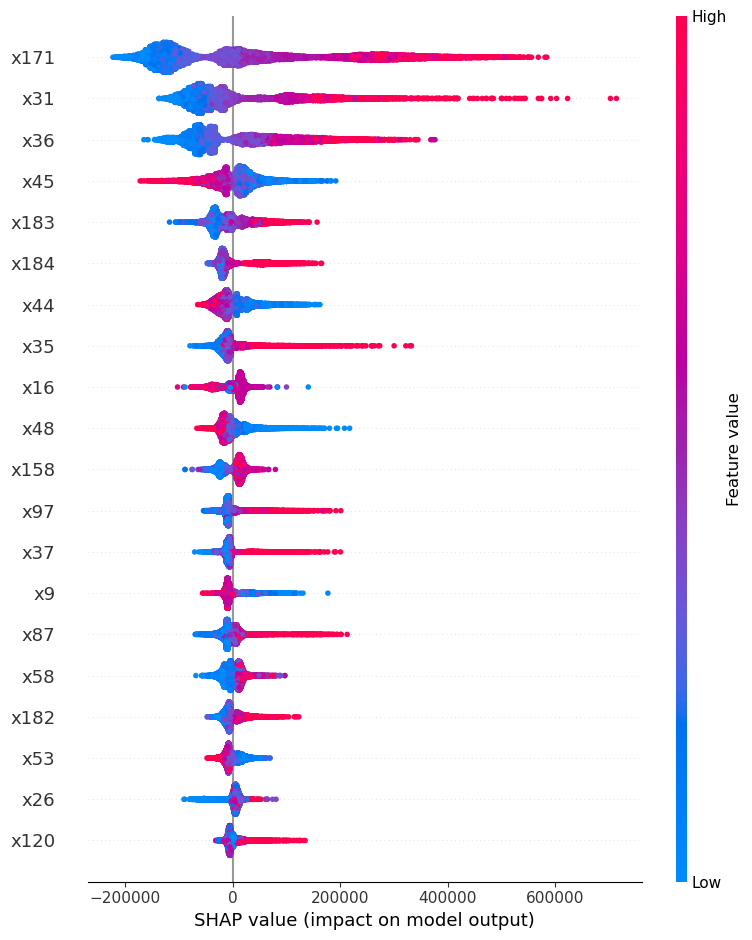

In [60]:
explainer = shap.TreeExplainer(best_lgbm)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values, X)

Анализ признаков очень затрудняется при использовании PolynominalFeatures. Рекомендую использовать такую генерацию признаков только в соревнованиях. В других случая следует обдуманно генерировать логичные признаки самостоятельно либо с привлечением эсперта из области проекта.  

### Сохранения и выгрузка данных. Вывод

In [61]:
test = pd.read_csv('C:/Users/solov/leoreg/test.csv')

In [62]:
test['Price'] = predictions_lgbm

In [63]:
test[['id', 'Price']].to_csv('lost_pred.csv', index= False)

В данном соревновании основная сложность - большое колличество пропущенных значений. Геогррафические метки получилось практически полностью заполнить вытянув значения изпользуя osmx, для других признаков использовали группировку и стандартное заполнение мода/медиана. Большое колличество уникальных значений в категориальных признаках, что ограничивает выбор инструментов для кодировки. Самии данные достаточно 'чистые' без явных аномалий, есть выбросы которые логически объяснимы спецификой данных. Учитывая что выбросы есть - для масштабирования был выбран MinMax (при использовании robust метрики были хуже). Применения полиноминальной автогенерации признаков дает прирост метрики но не позволяет провести внятный анализ. После экспериментов лучше показала себя модель LGBM по основным характеристикам время / точность. Что бы повысить значение метрики - необходимо точно заполнить пропуски используя реальные данные, которые как я понимаю специально были удалены из тренировочного дф. 

Итоговый скор MAPE = 15.94651. 